In [1]:
import pandas as pd
import os
import xml.etree.ElementTree as ET
from collections import Counter
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import patches
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import confusion_matrix, classification_report
import tensorflow as tf

from keras import layers
from keras import models
from keras.models import Sequential, load_model, Model
from keras.utils import plot_model
from keras.preprocessing.image import ImageDataGenerator
from keras.applications import MobileNetV2
from keras.applications.vgg16 import VGG16

from PIL import Image


## Read data

In [2]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [3]:
! unzip drive/MyDrive/Github/data.zip && mv drive/MyDrive/Github/data .

Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
  inflating: data/train/without_mask/img_3823.jpg  
  inflating: data/train/without_mask/img_6783.jpg  
  inflating: data/train/without_mask/img_6768.jpg  
  inflating: data/train/without_mask/img_3610.jpg  
  inflating: data/train/without_mask/img_781.jpg  
  inflating: data/train/without_mask/img_5507.jpg  
  inflating: data/train/without_mask/img_7304.jpg  
  inflating: data/train/without_mask/img_8037.jpg  
  inflating: data/train/without_mask/img_5513.jpg  
  inflating: data/train/without_mask/img_5275.jpg  
  inflating: data/train/without_mask/img_3604.jpg  
  inflating: data/train/without_mask/img_1013.jpg  
  inflating: data/train/without_mask/img_2532.jpg  
  inflating: data/train/without_mask/img_4143.jpg  
  inflating: data/train/without_mask/img_6032.jpg  
  inflating: data/train/without_mask/img_1985.jpg  
  inflating: data/train/without_mask/img_965.jpg  
  inflating: data/train/without_mask/img_2254.jpg  
 

In [ ]:
!rm -rf data/cropped && mkdir -p data/cropped


## Confusion matrix

In [ ]:
def show_confusion_matrix(matrix, labels=None):
    num_classes = matrix.shape[0]
    if labels is None:
      labels = [str(i) for i in range(num_classes)]
    plt.figure(figsize=(num_classes, num_classes))
    hm = sns.heatmap(matrix,
                cmap='coolwarm',
                linecolor='white',
                linewidths=1,
                xticklabels=labels[0:num_classes],
                yticklabels=labels[0:num_classes],
                annot=True,
                fmt='d')
    plt.yticks(rotation = 0)  # Don't rotate (vertically) the y-axis labels
    # hm.set_ylim(0, len(matrix))
    plt.title('Confusion Matrix')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.show()

def compute_and_show_confusion_matrix(validations, predictions, labels=None):
    matrix = metrics.confusion_matrix(validations, predictions)
    show_confusion_matrix(matrix, labels)

# First dataset - small

## Data reader

In [ ]:
class Parser:
    annotation_dir_name = 'data/annotations';
    image_dir_name = 'data/images';
    cropped_image_dir_name = 'data/cropped';
    final_image_dir_name = 'data/final_test'

    def load_image(self, path, img_filename):
        return cv2.imread(os.path.join(path, img_filename))

    def load_cropped_image(self, img_filename):
        return cv2.imread(os.path.join(Parser.cropped_image_dir_name, img_filename))

    def load_final_image(self, img_filename):
        return cv2.imread(os.path.join(Parser.final_image_dir_name, img_filename))

    def load_image_paths(self):
        return [ os.path.join(self.image_dir_name, img) for img in os.listdir(self.image_dir_name)]

    def load_cropped_image_paths(self):
        return [ os.path.join(self.cropped_image_dir_name, img) for img in os.listdir(self.cropped_image_dir_name)]

    def save_image_cropped_image(self, img_filename, img):
        cv2.imwrite(os.path.join(self.cropped_image_dir_name, img_filename), img)

    def annotation_parser(self):

        dict =  {
            'filename': [],
            'width': [],
            'height': [],
            'depth': [],
            'label': [],
            'y_min': [],
            'y_max': [],
            'x_min': [],
            'x_max': []
        }
        for  file in os.listdir(self.annotation_dir_name):
            tree = ET.parse(os.path.join(self.annotation_dir_name, file))
            for element in tree.iter():

                if 'filename' in element.tag:
                    filename = element.text

                if 'size' in element.tag:
                    for e in list(element):
                        if 'width' in e.tag:
                            width = int(e.text)
                        if 'height' in e.tag:
                            height = int(e.text)
                        if 'depth' in e.tag:
                            depth = int(e.text)
                if 'object' in element.tag:
                    for e in list(element):
                        if 'name' in e.tag:
                            name = e.text

                        if 'bndbox' in e.tag:
                            for attr in list(e):
                                if 'ymin' in attr.tag:
                                    dict['y_min'].append(int(attr.text))

                                if 'ymax' in attr.tag:
                                    dict['y_max'].append(int(attr.text))

                                if 'xmin' in attr.tag:
                                    dict['x_min'].append(int(attr.text))

                                if 'xmax' in attr.tag:
                                    dict['x_max'].append(int(attr.text))

                            dict['label'].append(name)
                            dict['width'].append(width)
                            dict['height'].append(height)
                            dict['depth'].append(depth)
                            dict['filename'].append(filename)
        return pd.DataFrame(dict)


parser = Parser()


In [ ]:
annotation_df = parser.annotation_parser()
images = parser.load_image_paths()

In [ ]:
def test_on_real_photo(model):
    # prepare data
    images = []
    for i, row in df_final_test.iterrows():
        img = parser.load_image(Parser.cropped_image_dir_name, row['cropped_filename'])
        images.append(img)

    ds = prepare_dataset(X=images, y=df_final_test['class'], resize=resizing, test=True)

    # predict
    probs = model.predict(ds)
    y_pred = np.argmax(probs,axis=1)
    print(y_pred)

    # display
    labels = ['green', 'red','yellow']
    annotation = ('with_mask', 'without_mask', 'mask_worn_incorrect')

    fig, ax = plt.subplots(1)
    img = parser.load_image(Parser.final_image_dir_name, "maksssksksss495.png")
    colored_img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    ax.imshow(colored_img)

    i = 0;
    for  idx, ann in df_final_test.iterrows():
        face_result = y_pred[i]
        rectangle = patches.Rectangle(
                xy=(ann['x_min'], ann['y_min']),
                width=ann['x_max'] - ann['x_min'],
                height=ann['y_max'] - ann['y_min'],
                linewidth=1,
                edgecolor=labels[face_result],
                facecolor='none'
                )
        ax.annotate(annotation[face_result], (ann['x_min'], ann['y_min']), color=labels[face_result])
        ax.add_patch(rectangle)
        i += 1
    plt.show()

### Data info

In [ ]:
annotation_df.head()

,filename,width,height,depth,label,y_min,y_max,x_min,x_max
0,maksssksksss825.png,400,225,3,with_mask,33,68,45,85
1,maksssksksss825.png,400,225,3,with_mask,20,52,135,169
2,maksssksksss825.png,400,225,3,with_mask,32,61,227,254
3,maksssksksss825.png,400,225,3,with_mask,30,58,300,330
4,maksssksksss808.png,301,400,3,with_mask,134,253,109,206


In [ ]:
annotation_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4072 entries, 0 to 4071
Data columns (total 9 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   filename  4072 non-null   object
 1   width     4072 non-null   int64 
 2   height    4072 non-null   int64 
 3   depth     4072 non-null   int64 
 4   label     4072 non-null   object
 5   y_min     4072 non-null   int64 
 6   y_max     4072 non-null   int64 
 7   x_min     4072 non-null   int64 
 8   x_max     4072 non-null   int64 
dtypes: int64(7), object(2)
memory usage: 286.4+ KB


Text(0.5, 1.0, 'Nb of labels')

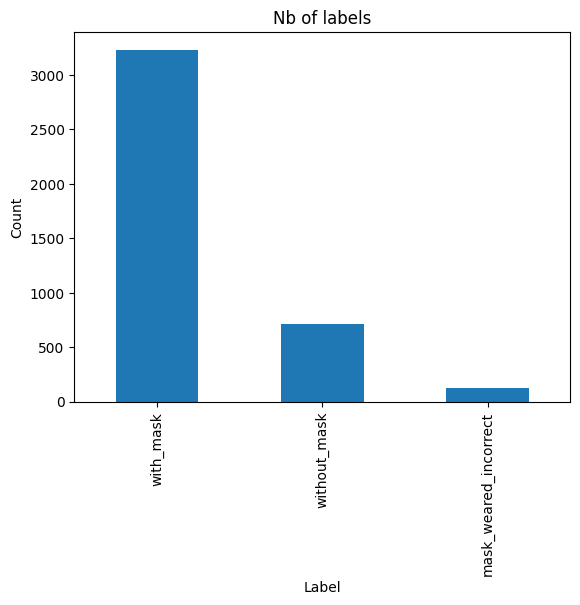

In [ ]:
annotation_df['label'].value_counts().plot(kind='bar')
plt.ylabel('Count')
plt.xlabel('Label')
plt.title('Nb of labels')

### Map label to numbers

In [ ]:
labels = { 'mask_weared_incorrect': 2,
           'without_mask': 1,
           'with_mask': 0,
           }

annotation_df['class'] = annotation_df['label'].map(labels)
annotation_df.head()

,filename,width,height,depth,label,y_min,y_max,x_min,x_max,class
0,maksssksksss825.png,400,225,3,with_mask,33,68,45,85,0
1,maksssksksss825.png,400,225,3,with_mask,20,52,135,169,0
2,maksssksksss825.png,400,225,3,with_mask,32,61,227,254,0
3,maksssksksss825.png,400,225,3,with_mask,30,58,300,330,0
4,maksssksksss808.png,301,400,3,with_mask,134,253,109,206,0


In [ ]:
!mkdir -p data/final_test && mv data/images/maksssksksss495.png data/final_test

mv: cannot stat 'data/images/maksssksksss495.png': No such file or directory


In [ ]:
df_final_test = annotation_df.loc[annotation_df["filename"] == "maksssksksss495.png"]
annotation_df = annotation_df[annotation_df["filename"] != "maksssksksss495.png"]

## Sample visualization

In [ ]:
df_final_test

,filename,width,height,depth,label,y_min,y_max,x_min,x_max,class
1286,maksssksksss495.png,400,225,3,without_mask,47,97,1,26,1
1287,maksssksksss495.png,400,225,3,mask_weared_incorrect,24,98,77,134,2
1288,maksssksksss495.png,400,225,3,with_mask,174,224,99,168,0
1289,maksssksksss495.png,400,225,3,without_mask,64,125,170,224,1
1290,maksssksksss495.png,400,225,3,with_mask,70,121,224,267,0
1291,maksssksksss495.png,400,225,3,without_mask,61,122,274,330,1
1292,maksssksksss495.png,400,225,3,with_mask,189,224,291,356,0
1293,maksssksksss495.png,400,225,3,with_mask,117,181,329,388,0
1294,maksssksksss495.png,400,225,3,without_mask,53,92,351,389,1


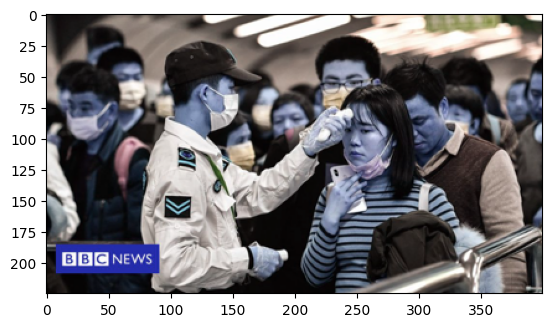

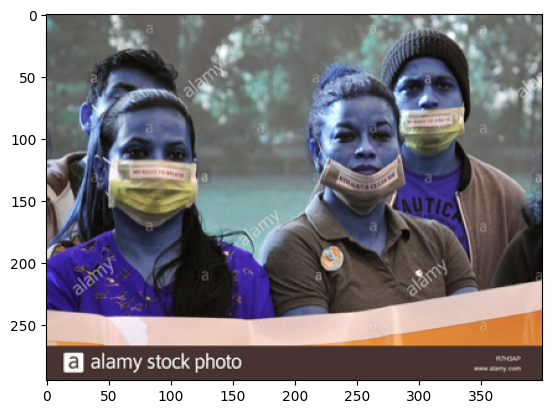

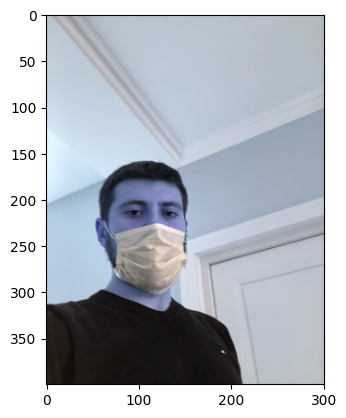

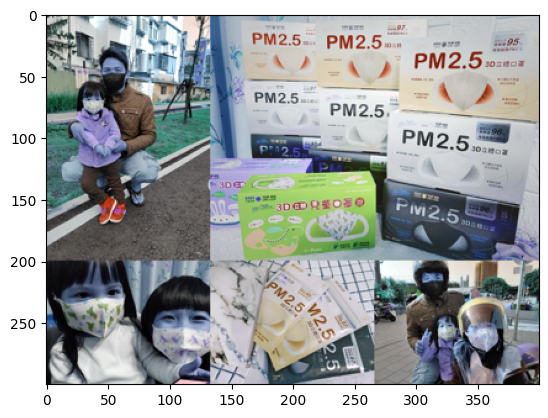

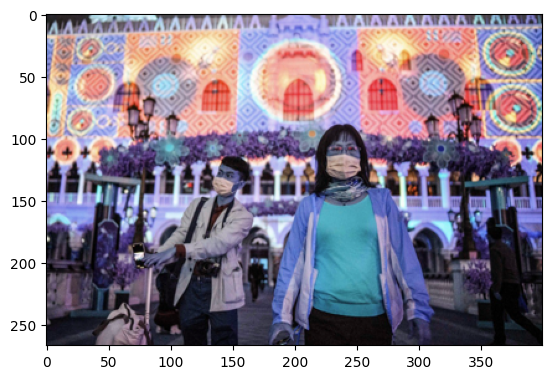

...

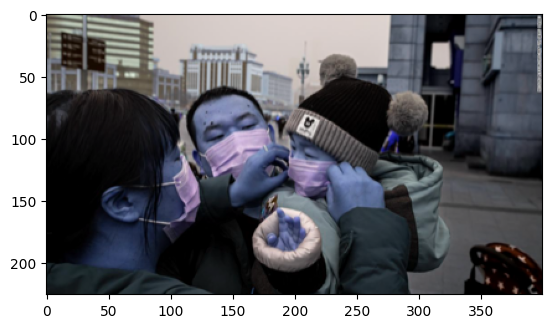

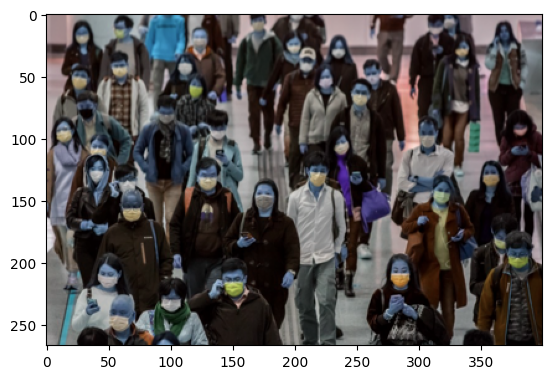

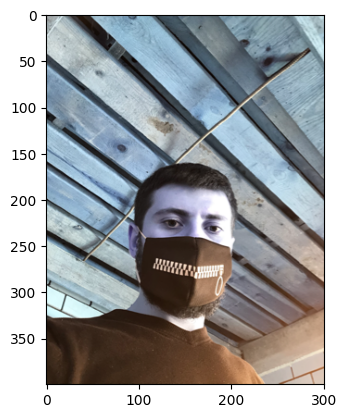

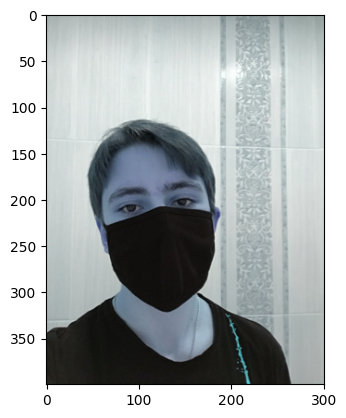

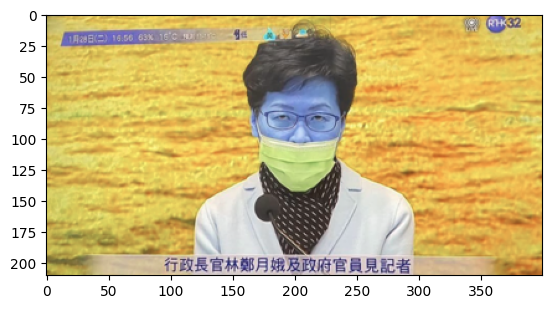

In [ ]:
for idx, image in enumerate(os.listdir(Parser.image_dir_name)):
    img = parser.load_image(Parser.image_dir_name, image)

    plt.imshow(img)
    plt.show()

    if idx == 10:
        break

In [ ]:
def plot_image_with_bounding_box(img_filename, annotation_data):

    labels = ['red', 'green', 'yellow']

    fig, ax = plt.subplots(1)
    ax.imshow(parser.load_image(Parser.image_dir_name, img_filename))

    for _, ann in annotation_data.iterrows():
        rectangle = patches.Rectangle(
            xy=(ann['x_min'], ann['y_min']),
            width=ann['x_max'] - ann['x_min'],
            height=ann['y_max'] - ann['y_min'],
            linewidth=1,
            edgecolor=labels[ann['class']],
            facecolor='none'
            )
        ax.annotate(ann['label'],(ann['x_min'], ann['y_min']), color=labels[ann['class']])
        ax.add_patch(rectangle)


    plt.show()



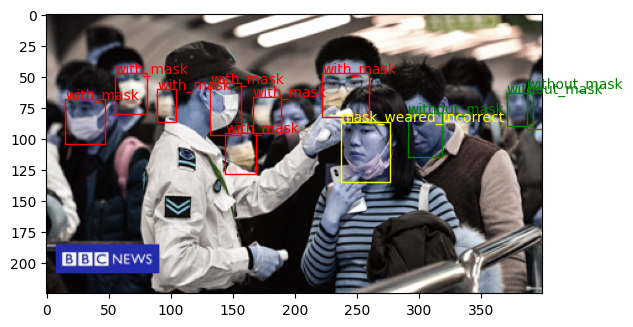

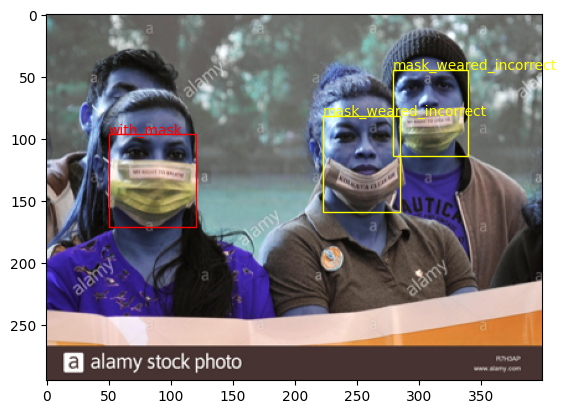

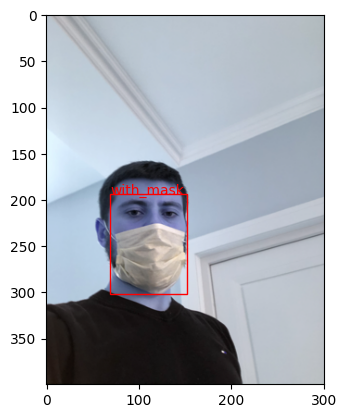

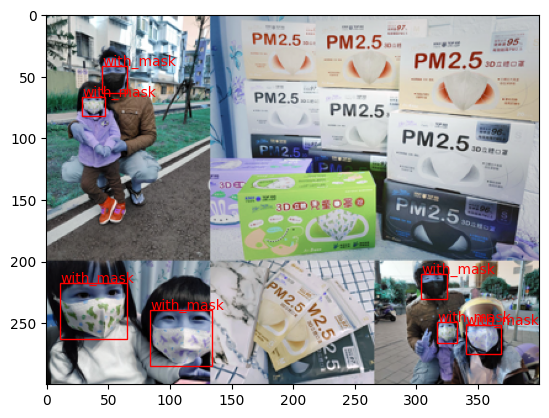

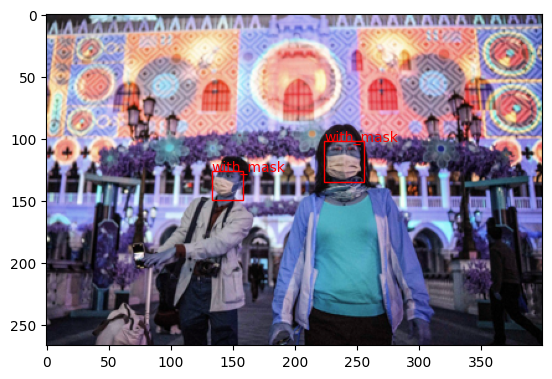

...

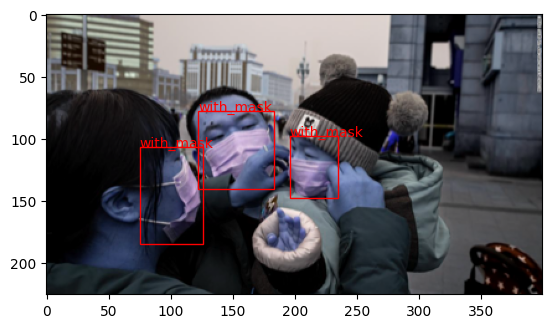

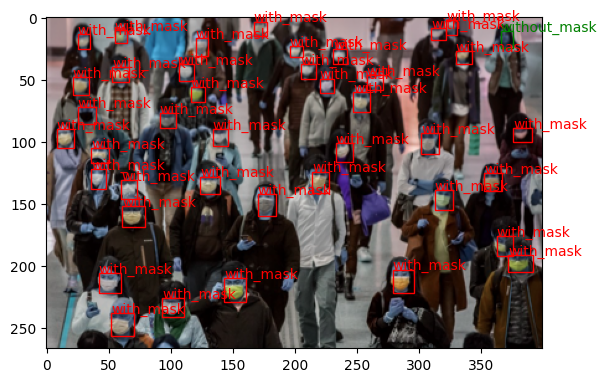

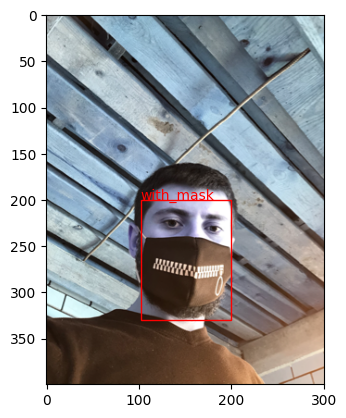

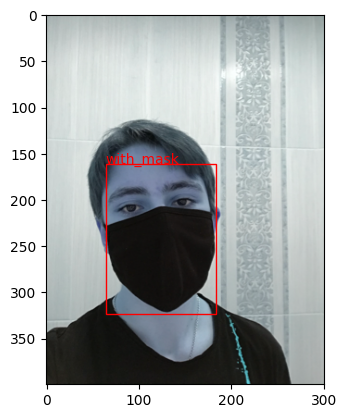

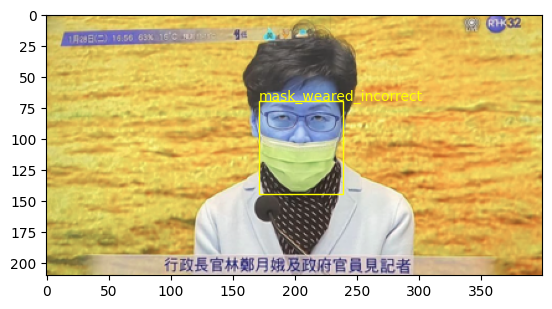

In [ ]:
for idx, image in enumerate(os.listdir(Parser.image_dir_name)):
    plot_image_with_bounding_box(image,annotation_df[annotation_df['filename'] == image],)

    if idx == 10:
        break

# First model - simple CNN

### Crop bounding boxes from images +- 5px  to get a single face and save files

In [ ]:
def crop_images(annotation_df, path):
    cropped_filename = []
    for index, row in annotation_df.iterrows():
        img = parser.load_image(path, row['filename'])
        filename = row['filename'].replace('.png', '-crop-' + str(index) + '.png')
        cropped_filename.append(filename)
        y_min = max(row['y_min'] - 10 , 0)
        y_max = min(row['y_max'] + 10, row['height'])
        x_min = max(row['x_min'] - 10, 0)
        x_max = min(row['x_max'] + 10, row['width'])


        cropped_image = img[y_min:y_max, x_min:x_max]
        parser.save_image_cropped_image(filename, cropped_image)
    annotation_df['cropped_filename'] = cropped_filename


In [ ]:
Parser.image_dir_name

'data/images'

In [ ]:
crop_images(annotation_df, Parser.image_dir_name)

In [ ]:
!ls data/cropped | wc -w

4063


In [ ]:
len(annotation_df)

4063

load cropped images to the memory


In [ ]:
images = []
width = []
height = []
X = []
y = []
for i, row in annotation_df.iterrows():
    img = parser.load_image(Parser.cropped_image_dir_name, row['cropped_filename'])
    images.append((row['class'], img))
    y.append(row['class'])
    X.append(img)
    width.append(img.shape[0])
    height.append(img.shape[1])



find height and width distribution

In [ ]:
def plot_with_distribution(width):
    plt.hist(width, bins=50)
    plt.xlabel("Image width")
    plt.ylabel("Count")
    plt.title("Image width distribution")
    plt.show()

In [ ]:
def plot_height_distribution(height):
    plt.hist(height, bins=50)
    plt.xlabel("Image width")
    plt.ylabel("Count")
    plt.title("Image width distribution")
    plt.show()

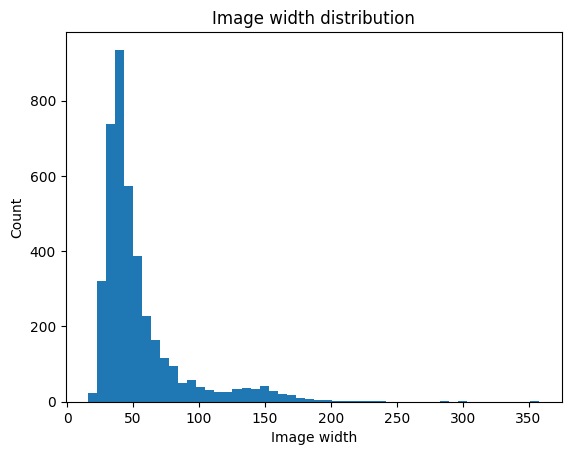

In [ ]:
plot_with_distribution(width)

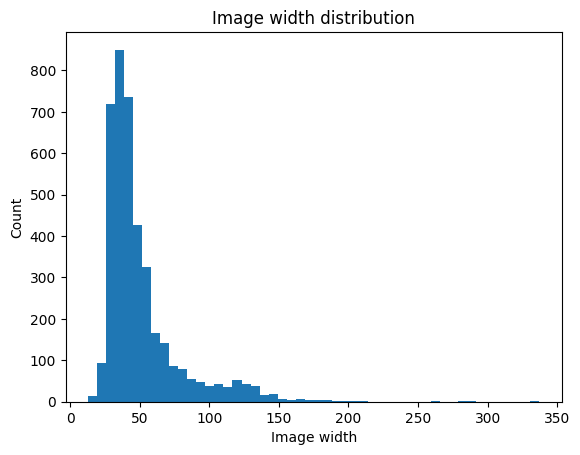

In [ ]:
plot_height_distribution(height)

In [ ]:
img_height = int(np.median(height))
img_width = int(np.median(width))
print(img_height)
print(img_width)

42
44


### Prepare dataset for training/testing/validation

In [ ]:
def prepare_dataset(X, y, batch_size=32, resize=None, test=None):
    if resize is not None:
        X = [ resize(img).numpy() for img in X ]

    ds = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))
    if test is None:
        ds = ds.shuffle(len(X))

    ds = ds.batch(batch_size)

    return ds

Resize images to desired size and normlise pixels to [0,1] range

In [ ]:
resizing = models.Sequential([
    layers.Resizing(img_height,img_width),
    layers.Rescaling(1./255)
])

### Split data into training/testing/validating

In [ ]:
X_data, X_test, y_data, y_test = train_test_split(X, y, test_size=0.1, random_state=7)
X_train, X_val, y_train, y_val = train_test_split(X_data, y_data, test_size=0.2, random_state=7)
len(X_train), len(y_train), len(X_val), len(y_val)

(2924, 2924, 732, 732)

In [ ]:
ds_train = prepare_dataset(X_train, y_train, resize=resizing)
ds_train.element_spec

(TensorSpec(shape=(None, 42, 44, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None,), dtype=tf.int32, name=None))

In [ ]:
ds_val = prepare_dataset(X_val, y_val, resize=resizing)
ds_val.element_spec

(TensorSpec(shape=(None, 42, 44, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None,), dtype=tf.int32, name=None))

In [ ]:
ds_test = prepare_dataset(X_test, y_test, resize=resizing, test=True)
ds_test.element_spec

(TensorSpec(shape=(None, 42, 44, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None,), dtype=tf.int32, name=None))

In [ ]:
def split_dataset(X, y, resizing=None):
    X_data, X_test, y_data, y_test = train_test_split(X, y, test_size=0.1, random_state=7)
    X_train, X_val, y_train, y_val = train_test_split(X_data, y_data, test_size=0.2, random_state=7)

    ds_train = prepare_dataset(X_train, y_train, resize=resizing)
    ds_val = prepare_dataset(X_val, y_val, resize=resizing)
    ds_test = prepare_dataset(X_test, y_test, resize=resizing, test=True)

    return ds_train, ds_val, ds_test, y_test

### Model preparation

In [ ]:
cnn_model = models.Sequential([
    layers.Conv2D(16, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0,1),

    layers.Conv2D(32, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0,1),

    layers.Conv2D(64, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0,1),

    layers.Flatten(),

    layers.Dense(512, activation='relu'),
    layers.Dense(3, activation='softmax')
])

cnn_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 40, 42, 16)        448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 20, 21, 16)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 20, 21, 16)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 18, 19, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 9, 9, 32)         0         
 2D)                                                             
                                                                 
 dropout_1 (Dropout)         (None, 9, 9, 32)         

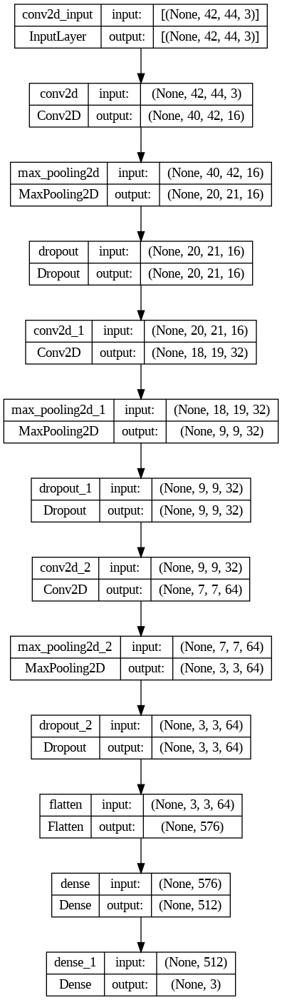

In [ ]:
plot_model(cnn_model, show_shapes=True, show_layer_names=True)

In [ ]:
from keras.optimizers import RMSprop
cnn_model.compile(loss='sparse_categorical_crossentropy',
                  optimizer=RMSprop(learning_rate=0.001),
                  metrics=['accuracy']
                )

### Learning

In [ ]:
epochs = 100
hist_cnn = cnn_model.fit(ds_train, epochs=epochs, validation_data=ds_val)

Epoch 1/100
92/92 [==============================] - 10s 10ms/step - loss: 0.4430 - accuracy: 0.8348 - val_loss: 0.2445 - val_accuracy: 0.9208
Epoch 2/100
92/92 [==============================] - 1s 7ms/step - loss: 0.2583 - accuracy: 0.9121 - val_loss: 0.2921 - val_accuracy: 0.9139
Epoch 3/100
92/92 [==============================] - 1s 8ms/step - loss: 0.2194 - accuracy: 0.9285 - val_loss: 0.1926 - val_accuracy: 0.9399
Epoch 4/100
92/92 [==============================] - 1s 7ms/step - loss: 0.1932 - accuracy: 0.9360 - val_loss: 0.1910 - val_accuracy: 0.9454
Epoch 5/100
92/92 [==============================] - 1s 7ms/step - loss: 0.1668 - accuracy: 0.9425 - val_loss: 0.1762 - val_accuracy: 0.9508
Epoch 6/100
92/92 [==============================] - 1s 5ms/step - loss: 0.1533 - accuracy: 0.9484 - val_loss: 0.2037 - val_accuracy: 0.9358
Epoch 7/100
92/92 [==============================] - 1s 5ms/step - loss: 0.1387 - accuracy: 0.9487 - val_loss: 0.1928 - val_accuracy: 0.9317
Epoch 8/100

In [ ]:
def plot_accuracy_and_loss_model(history):
    plt.figure(figsize=(15,8))
    plt.title("Accuracy")
    plt.plot(history.history['accuracy'], label='acc')
    plt.plot(history.history['val_accuracy'], label='val_acc')
    plt.legend()
    plt.show()

    plt.figure(figsize=(15,8))
    plt.title("Loss")
    plt.plot(history.history['loss'], label='loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.legend()
    plt.show()

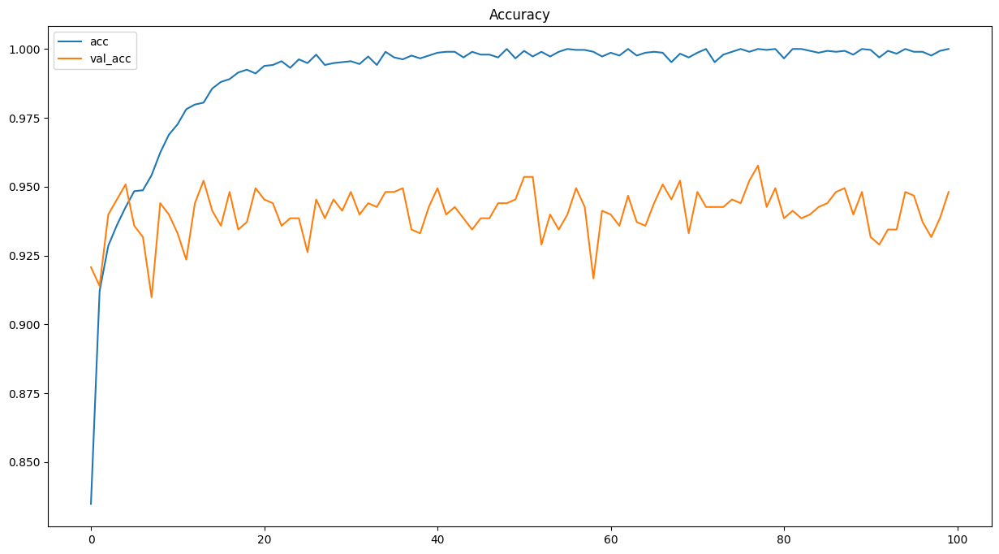

In [ ]:
plt.figure(figsize=(15,8))
plt.title("Accuracy")
plt.plot(hist_cnn.history['accuracy'], label='acc')
plt.plot(hist_cnn.history['val_accuracy'], label='val_acc')
plt.legend()
plt.show()

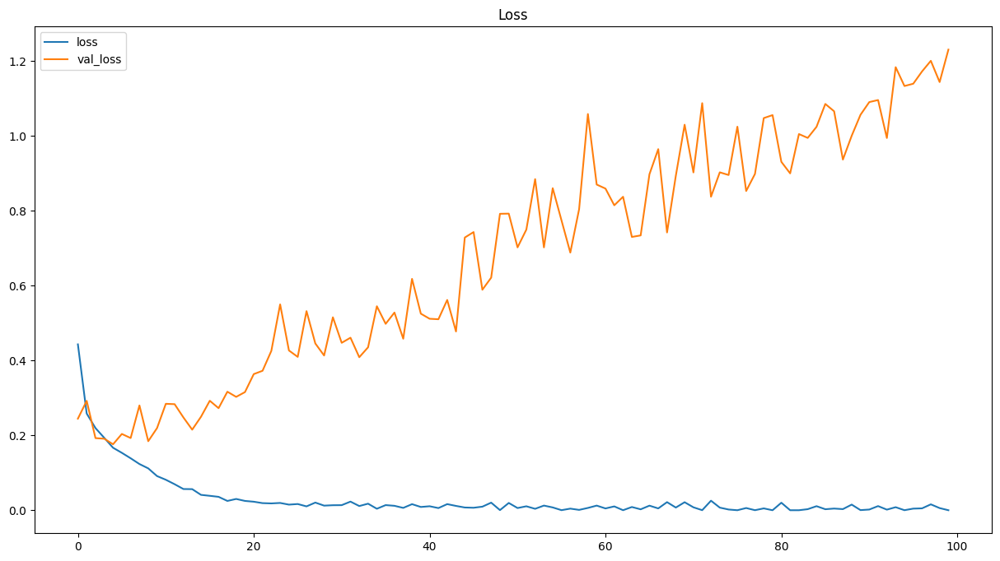

In [ ]:
plt.figure(figsize=(15,8))
plt.title("Loss")
plt.plot(hist_cnn.history['loss'], label='loss')
plt.plot(hist_cnn.history['val_loss'], label='val_loss')
plt.legend()
plt.show()

In [ ]:
loss, acc = cnn_model.evaluate(ds_test)
print("Accuracy: ",acc)

13/13 [==============================] - 0s 9ms/step - loss: 1.9096 - accuracy: 0.9386
Accuracy:  0.9385749101638794


In [ ]:
probs = cnn_model.predict(ds_test)
print(f'{probs.shape}')
y_pred = np.argmax(probs,axis=1)

13/13 [==============================] - 0s 2ms/step
(407, 3)


In [ ]:
def show_classification_report_and_confusion_matrix(model, ds_test):
    probs = cnn_model.predict(ds_test)
    print(f'{probs.shape}')
    y_pred = np.argmax(probs,axis=1)

    print(classification_report(y_test, y_pred))
    compute_and_show_confusion_matrix(y_test, y_pred)

In [ ]:
print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

           0       0.95      0.98      0.96       324
           1       0.88      0.89      0.88        72
           2       1.00      0.18      0.31        11

    accuracy                           0.94       407
   macro avg       0.94      0.68      0.72       407
weighted avg       0.94      0.94      0.93       407



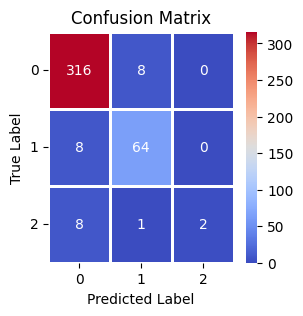

In [ ]:
compute_and_show_confusion_matrix(y_test, y_pred)

### testing model on image that was not included in training and testing

In [ ]:
cropped_images = crop_images(df_final_test, Parser.final_image_dir_name)

In [ ]:
df_final_test

,filename,width,height,depth,label,y_min,y_max,x_min,x_max,class,cropped_filename
1286,maksssksksss495.png,400,225,3,without_mask,47,97,1,26,1,maksssksksss495-crop-1286.png
1287,maksssksksss495.png,400,225,3,mask_weared_incorrect,24,98,77,134,2,maksssksksss495-crop-1287.png
1288,maksssksksss495.png,400,225,3,with_mask,174,224,99,168,0,maksssksksss495-crop-1288.png
1289,maksssksksss495.png,400,225,3,without_mask,64,125,170,224,1,maksssksksss495-crop-1289.png
1290,maksssksksss495.png,400,225,3,with_mask,70,121,224,267,0,maksssksksss495-crop-1290.png
1291,maksssksksss495.png,400,225,3,without_mask,61,122,274,330,1,maksssksksss495-crop-1291.png
1292,maksssksksss495.png,400,225,3,with_mask,189,224,291,356,0,maksssksksss495-crop-1292.png
1293,maksssksksss495.png,400,225,3,with_mask,117,181,329,388,0,maksssksksss495-crop-1293.png
1294,maksssksksss495.png,400,225,3,without_mask,53,92,351,389,1,maksssksksss495-crop-1294.png


In [ ]:
img_width

44

1/1 [==============================] - 0s 256ms/step
[1 0 0 1 0 1 0 0 1]


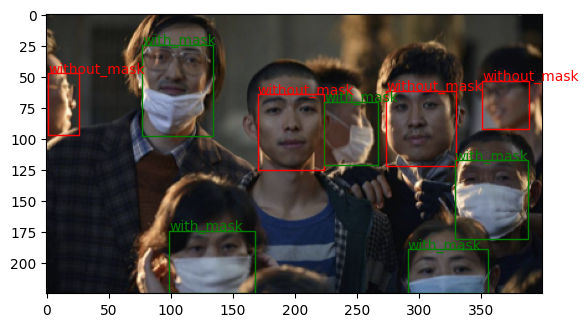

In [ ]:
test_on_real_photo(cnn_model)

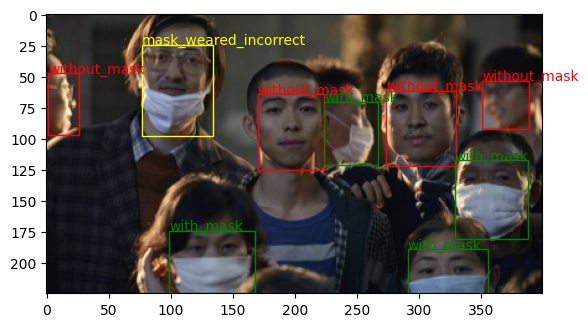

In [ ]:
labels = ['green', 'red', 'yellow']

fig, ax = plt.subplots(1)
img = parser.load_image(Parser.final_image_dir_name, "maksssksksss495.png")
colored_img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
ax.imshow(colored_img)

for _, ann in df_final_test.iterrows():
    rectangle = patches.Rectangle(
        xy=(ann['x_min'], ann['y_min']),
        width=ann['x_max'] - ann['x_min'],
        height=ann['y_max'] - ann['y_min'],
        linewidth=1,
        edgecolor=labels[ann['class']],
        facecolor='none'
        )
    ax.annotate(ann['label'],(ann['x_min'], ann['y_min']), color=labels[ann['class']])
    ax.add_patch(rectangle)


plt.show()

# Bigger Database

## Read splited data into different generators

In [ ]:
img_height = 128
img_width = 128

In [ ]:
datagen = ImageDataGenerator(rescale=1./255)

train_it = datagen.flow_from_directory('data/train/', class_mode='binary', batch_size=32, target_size=(img_height, img_width), shuffle=True)
# load and iterate validation dataset
val_it = datagen.flow_from_directory('data/validation/', class_mode='binary', batch_size=32, target_size=(img_height, img_width), shuffle=False)
# load and iterate test dataset
test_it = datagen.flow_from_directory('data/test/', class_mode='binary', batch_size=32, target_size=(img_height,img_width), shuffle=False)

Found 8665 images belonging to 3 classes.
Found 2167 images belonging to 3 classes.
Found 1204 images belonging to 3 classes.


In [ ]:
import tqdm

# Reset the generator
test_it.reset()

# Initialize empty arrays for storing true values and image data
true_labels = []
image_data = []

# Iterate over the test dataset and extract true labels and image data
for _ in tqdm.tqdm(range(int(test_it.n / test_it.batch_size))):
    images, labels = next(test_it)
    image_data.extend(images)
    true_labels.extend(labels)

# Convert the lists to NumPy arrays
X_test = np.array(image_data)
y_test = np.array(true_labels)


100%|██████████| 37/37 [00:12<00:00,  3.03it/s]


In [ ]:
resizing = models.Sequential([
    layers.Resizing(img_height,img_width),
])

In [ ]:
from keras.callbacks import EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True)


In [ ]:
def test_on_real_photo(model):
    # prepare data
    images = []
    for i, row in df_final_test.iterrows():
        img = parser.load_image(Parser.cropped_image_dir_name, row['cropped_filename'])
        images.append(img)

    X = np.array([ resizing(img).numpy() for img in images ])

    test_it = datagen.flow(X,batch_size=1, shuffle=False)

    # predict
    probs = model.predict(test_it)
    y_pred = np.argmax(probs,axis=1)
    print(y_pred)

    # display
    labels = ['red', 'green', 'yellow']
    annotation = ('without_mask', 'with_mask', 'mask_worn_incorrect')

    fig, ax = plt.subplots(1)
    img = parser.load_image(Parser.final_image_dir_name, "maksssksksss495.png")
    colored_img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    ax.imshow(colored_img)

    i = 0;
    for  idx, ann in df_final_test.iterrows():
        face_result = y_pred[i]
        rectangle = patches.Rectangle(
                xy=(ann['x_min'], ann['y_min']),
                width=ann['x_max'] - ann['x_min'],
                height=ann['y_max'] - ann['y_min'],
                linewidth=1,
                edgecolor=labels[face_result],
                facecolor='none'
                )
        ax.annotate(annotation[face_result], (ann['x_min'], ann['y_min']), color=labels[face_result])
        ax.add_patch(rectangle)
        i += 1
    plt.show()

## First CNN model

## training

In [ ]:
cnn_model = models.Sequential([
    layers.Conv2D(16, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0,1),

    layers.Conv2D(32, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0,1),

    layers.Conv2D(64, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0,1),

    layers.Flatten(),

    layers.Dense(128, activation='relu'),
    layers.Dense(3, activation='softmax')
])

cnn_model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 126, 126, 16)      448       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 63, 63, 16)       0         
 2D)                                                             
                                                                 
 dropout_6 (Dropout)         (None, 63, 63, 16)        0         
                                                                 
 conv2d_7 (Conv2D)           (None, 61, 61, 32)        4640      
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 30, 30, 32)       0         
 2D)                                                             
                                                                 
 dropout_7 (Dropout)         (None, 30, 30, 32)       

In [ ]:
from keras.optimizers import RMSprop
cnn_model.compile(loss='sparse_categorical_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy']
                )




In [ ]:
epochs = 30
hist_cnn = cnn_model.fit(
            train_it,
            epochs=epochs,
            validation_data=val_it,
            max_queue_size=100,
            workers = 5 ,
            use_multiprocessing=True,
            steps_per_epoch = train_it.samples//32,
            validation_steps = val_it.samples//32,
            callbacks = [early_stopping]
)
cnn_model.save('cnn_model1')


Epoch 1/30
270/270 [==============================] - 336s 1s/step - loss: 0.2735 - accuracy: 0.9004 - val_loss: 0.1927 - val_accuracy: 0.9370
Epoch 2/30
270/270 [==============================] - 307s 1s/step - loss: 0.1691 - accuracy: 0.9414 - val_loss: 0.1763 - val_accuracy: 0.9473
Epoch 3/30
270/270 [==============================] - 329s 1s/step - loss: 0.1382 - accuracy: 0.9503 - val_loss: 0.2100 - val_accuracy: 0.9347
Epoch 4/30
270/270 [==============================] - 345s 1s/step - loss: 0.1080 - accuracy: 0.9578 - val_loss: 0.1835 - val_accuracy: 0.9356
Epoch 5/30
270/270 [==============================] - 327s 1s/step - loss: 0.0887 - accuracy: 0.9666 - val_loss: 0.1953 - val_accuracy: 0.9436
Epoch 6/30
270/270 [==============================] - 306s 1s/step - loss: 0.0635 - accuracy: 0.9751 - val_loss: 0.1816 - val_accuracy: 0.9557
Epoch 7/30
270/270 [==============================] - 347s 1s/step - loss: 0.0437 - accuracy: 0.9854 - val_loss: 0.1842 - val_accuracy: 0.9454

In [4]:
if not 'cnn_model' in vars():
    cnn_model = load_model("drive/MyDrive/models/cnn_model_fc")


### testing

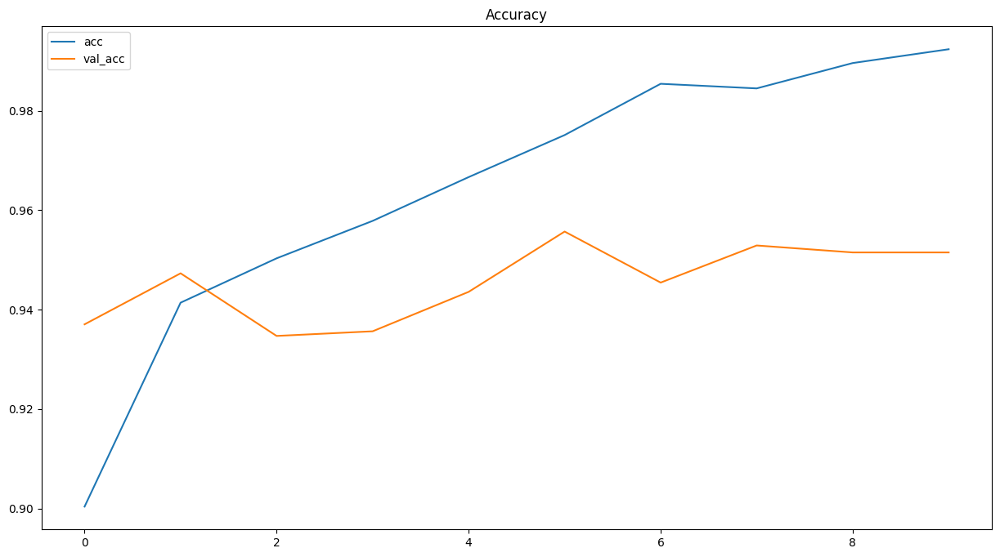

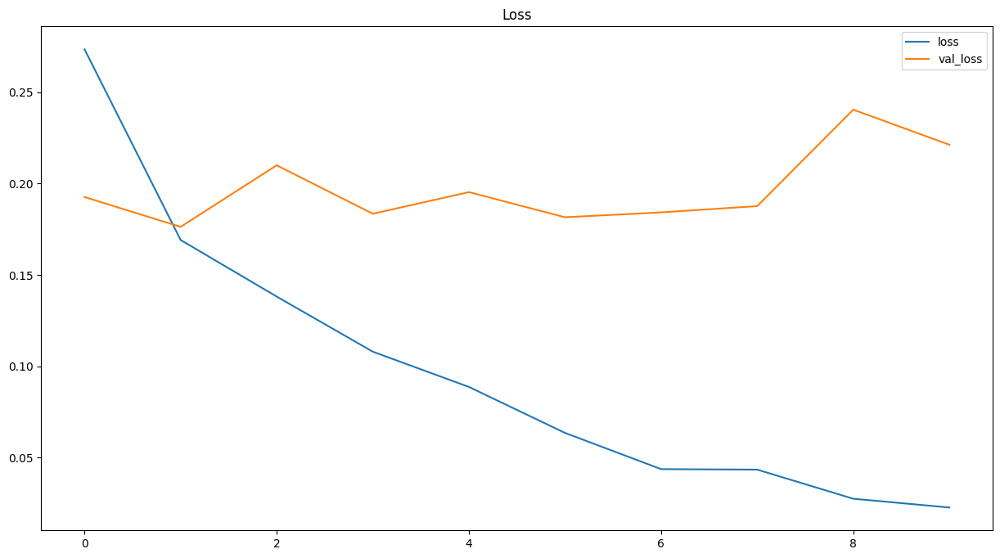

In [ ]:
plot_accuracy_and_loss_model(hist_cnn)

In [ ]:
loss, acc = cnn_model.evaluate(test_it, steps=test_it.samples//32)
print("Accuracy: ",acc)

37/37 [==============================] - 11s 302ms/step - loss: 0.1575 - accuracy: 0.9392
Accuracy:  0.9391891956329346


In [ ]:
probs = cnn_model.predict(test_it, steps=test_it.samples//32)

print(f'{probs.shape}')
y_pred = np.argmax(probs,axis=1)

37/37 [==============================] - 12s 310ms/step
(1184, 3)


In [ ]:
print(classification_report(y_test.astype(int), y_pred))

              precision    recall  f1-score   support

           0       0.94      0.91      0.93       495
           1       0.92      0.95      0.93       477
           2       0.99      0.97      0.98       212

    accuracy                           0.94      1184
   macro avg       0.95      0.95      0.95      1184
weighted avg       0.94      0.94      0.94      1184



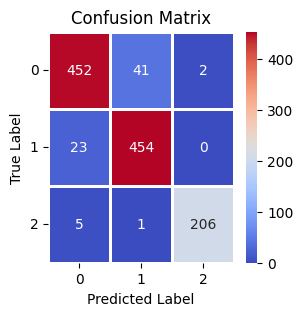

In [ ]:
compute_and_show_confusion_matrix(y_test, y_pred)

9/9 [==============================] - 0s 3ms/step
[0 1 1 0 2 1 1 1 0]


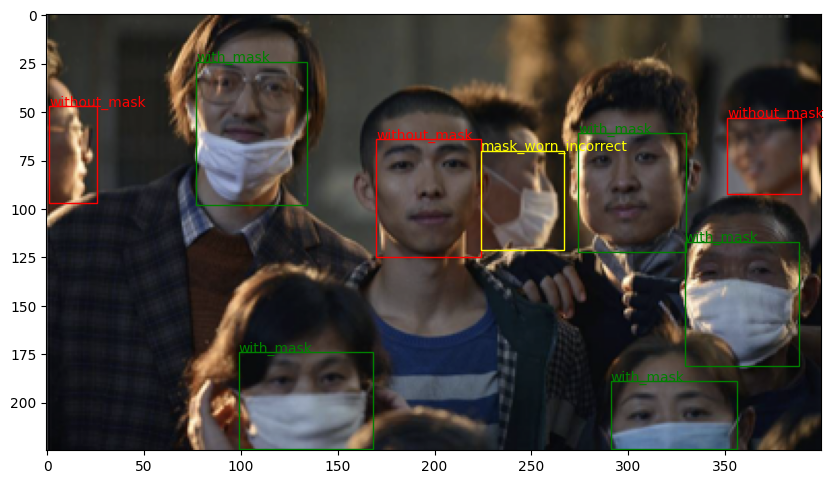

In [ ]:
test_on_real_photo(cnn_model)

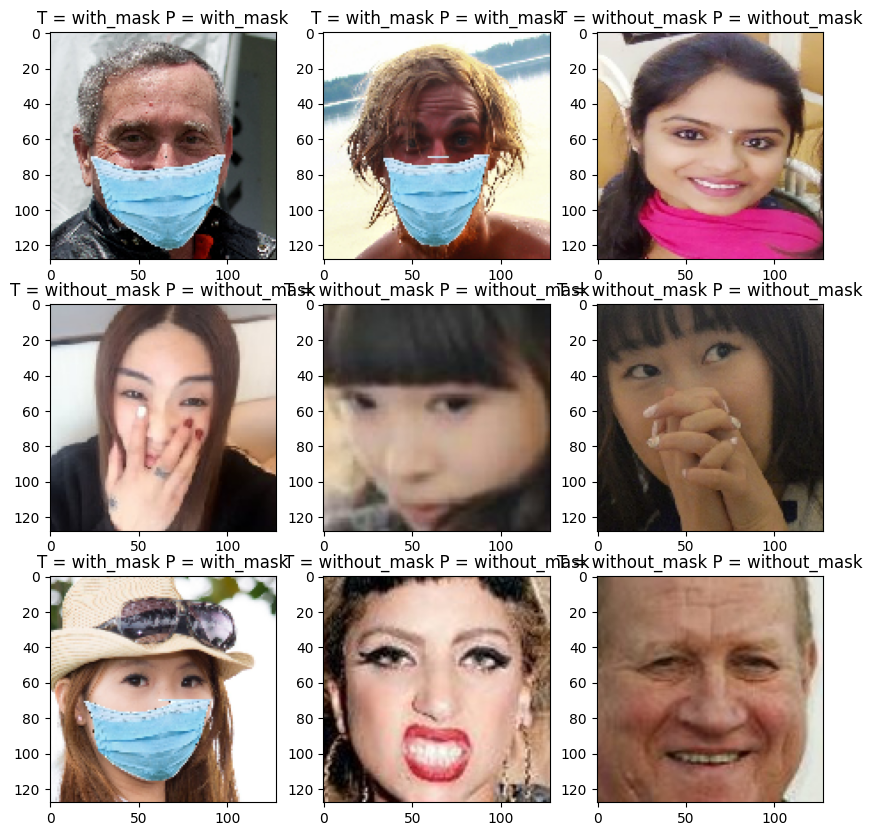

In [ ]:
plt.rcParams["figure.figsize"] = (10,10)
import random
index = 0
# random.seed(42)

labels = ['with_mask', 'without_mask', 'worn_incorrectly']

for i in  random.sample(range(0, 1084), 9):
  ax = plt.subplot(330 + 1 + index)
  plt.imshow(X_test[i])
  ax.set_title('T = ' + labels[int(y_test[i])] + ' P = ' + labels[int(y_pred[i])])
  index +=1
plt.show()

## Second CNN Model

### training

In [ ]:
cnn_model2 = models.Sequential([
    layers.Conv2D(16, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),

    layers.Conv2D(32, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),

    layers.Conv2D(64, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),

    layers.Conv2D(128, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),

    layers.Conv2D(256, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),

    layers.Dropout(0,3),
    layers.Flatten(),

    layers.Dense(128, activation='relu'),
    layers.Dense(3, activation='softmax')
])

cnn_model2.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 126, 126, 16)      448       
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 63, 63, 16)       0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 61, 61, 32)        4640      
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 30, 30, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_11 (Conv2D)          (None, 28, 28, 64)        18496     
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 14, 14, 64)      

In [ ]:
cnn_model2.compile(loss='sparse_categorical_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy']
                )

In [ ]:
epochs = 30
hist_cnn = cnn_model2.fit(
            train_it,
            epochs=epochs,
            validation_data=val_it,
            max_queue_size=100,
            workers = 5 ,# (set a proper value > 1)
            use_multiprocessing=True,
            steps_per_epoch = train_it.samples//32,
            validation_steps = val_it.samples//32,
            callbacks = [early_stopping]
)
cnn_model2.save('cnn_model2.h')


Epoch 1/30
270/270 [==============================] - 352s 1s/step - loss: 0.2751 - accuracy: 0.9020 - val_loss: 0.1825 - val_accuracy: 0.9445
Epoch 2/30
270/270 [==============================] - 338s 1s/step - loss: 0.1709 - accuracy: 0.9405 - val_loss: 0.1488 - val_accuracy: 0.9496
Epoch 3/30
270/270 [==============================] - 366s 1s/step - loss: 0.1445 - accuracy: 0.9508 - val_loss: 0.1593 - val_accuracy: 0.9506
Epoch 4/30
270/270 [==============================] - 353s 1s/step - loss: 0.1326 - accuracy: 0.9552 - val_loss: 0.1392 - val_accuracy: 0.9557
Epoch 5/30
270/270 [==============================] - 341s 1s/step - loss: 0.1240 - accuracy: 0.9596 - val_loss: 0.1515 - val_accuracy: 0.9506
Epoch 6/30
270/270 [==============================] - 337s 1s/step - loss: 0.1097 - accuracy: 0.9613 - val_loss: 0.1351 - val_accuracy: 0.9594
Epoch 7/30
270/270 [==============================] - 358s 1s/step - loss: 0.0992 - accuracy: 0.9671 - val_loss: 0.1332 - val_accuracy: 0.9613

In [12]:
if not 'cnn_model2' in vars():
    cnn_model2 = load_model("drive/MyDrive/models/cnn_model2_fc")

In [ ]:
! pip install visualkeras


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.0/993.0 kB 21.8 MB/s eta 0:00:00


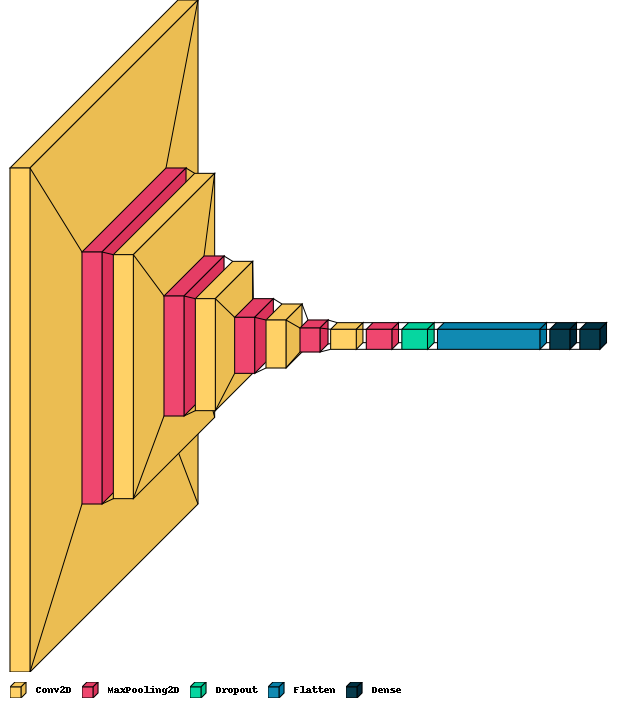

In [ ]:
import visualkeras
visualkeras.layered_view(cnn_model2, legend=True).show()


### testing

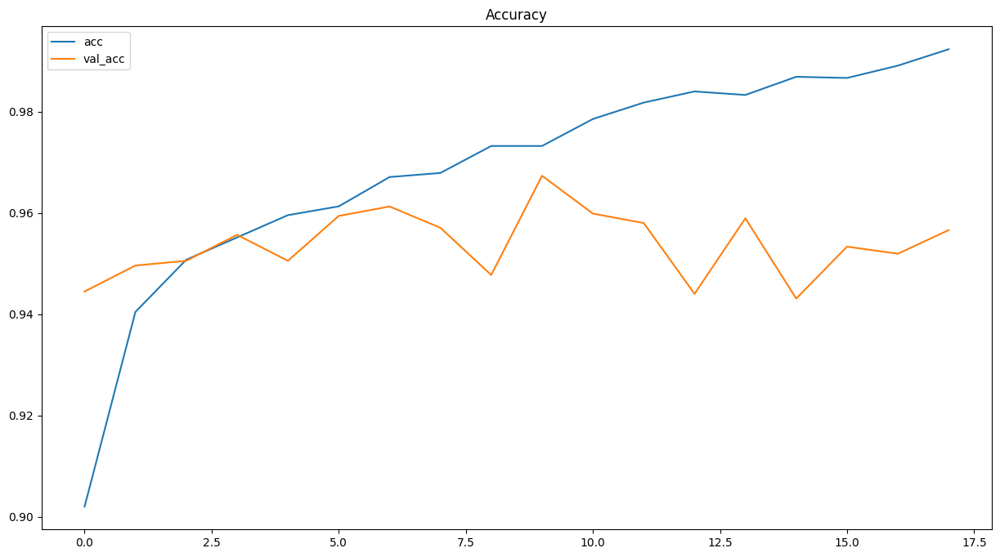

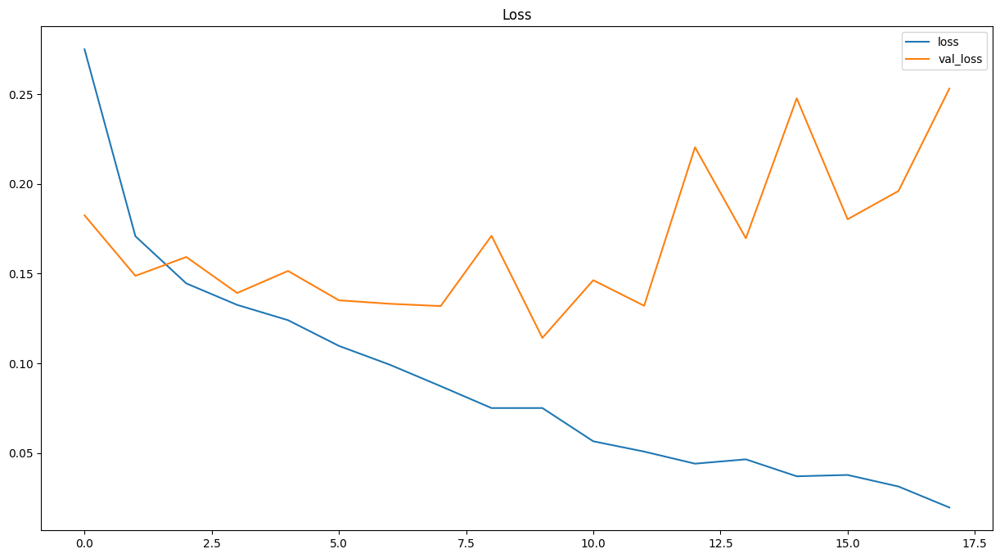

In [ ]:
plot_accuracy_and_loss_model(hist_cnn)

In [ ]:
loss, acc = cnn_model2.evaluate(test_it, steps=test_it.samples//32)
print("Accuracy: ",acc)

37/37 [==============================] - 11s 288ms/step - loss: 0.1237 - accuracy: 0.9544
Accuracy:  0.9543918967247009


In [ ]:
probs = cnn_model2.predict(test_it, steps=test_it.samples//32)

print(f'{probs.shape}')
y_pred = np.argmax(probs,axis=1)

37/37 [==============================] - 14s 365ms/step
(1184, 3)


In [ ]:
print(classification_report(y_test.astype(int), y_pred))

              precision    recall  f1-score   support

           0       0.95      0.94      0.94       495
           1       0.94      0.96      0.95       477
           2       0.99      0.98      0.98       212

    accuracy                           0.95      1184
   macro avg       0.96      0.96      0.96      1184
weighted avg       0.95      0.95      0.95      1184



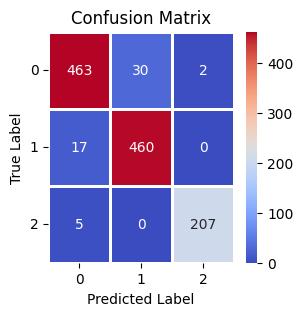

In [ ]:
compute_and_show_confusion_matrix(y_test, y_pred)

9/9 [==============================] - 0s 3ms/step
[0 1 1 0 0 0 1 1 1]


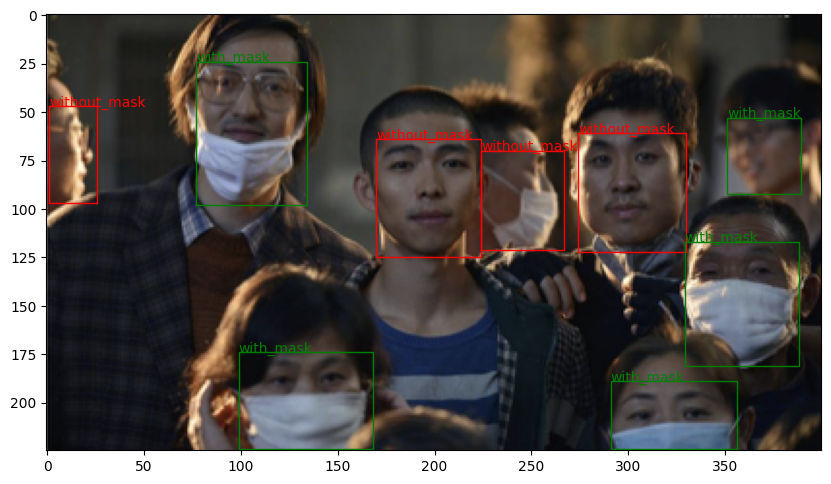

In [ ]:
test_on_real_photo(cnn_model2)

In [ ]:
len(y_pred)

407

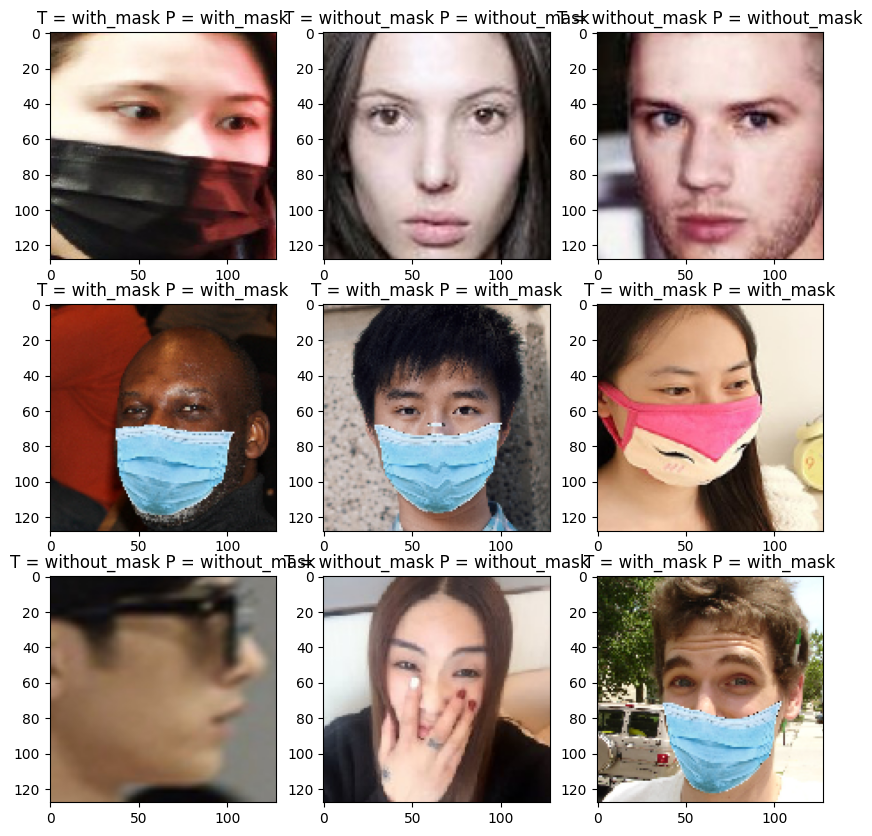

In [ ]:
plt.rcParams["figure.figsize"] = (10,10)
import random
index = 0
# random.seed(42)

labels = ['with_mask', 'without_mask', 'worn_incorrectly']

for i in  random.sample(range(0, 1084), 9):
  ax = plt.subplot(330 + 1 + index)
  plt.imshow(X_test[i])
  ax.set_title('T = ' + labels[int(y_test[i])] + ' P = ' + labels[int(y_pred[i])])
  index +=1
plt.show(f

## VGG Model

In [ ]:
def define_vgg16_model():
  # load model
  model = VGG16(include_top=False, input_shape=(128, 128, 3))
#   mark loaded layers as not trainable
  for layer in model.layers[:15]:
    layer.trainable = False
  # add new classifier layers
  full_model = models.Sequential([
      model,
      layers.Flatten(),
      layers.Dense(128, activation='relu', kernel_initializer='he_uniform'),
      layers.Dense(3, activation='softmax')
      ])

  full_model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

  return full_model

vgg_model = define_vgg16_model()

In [ ]:
vgg_model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 flatten_4 (Flatten)         (None, 8192)              0         
                                                                 
 dense_8 (Dense)             (None, 128)               1048704   
                                                                 
 dense_9 (Dense)             (None, 3)                 387       
                                                                 
Total params: 15,763,779
Trainable params: 8,128,515
Non-trainable params: 7,635,264
_________________________________________________________________


In [ ]:
epochs = 30
hist_cnn = vgg_model.fit(
            train_it,
            epochs=epochs,
            validation_data=val_it,
            max_queue_size=100,
            workers = 5 ,# (set a proper value > 1)
            use_multiprocessing=True,
            steps_per_epoch = train_it.samples//32,
            validation_steps = val_it.samples//32,
            callbacks = [early_stopping]
)

vgg_model.save("vgg_model_fc")

Epoch 1/30
270/270 [==============================] - 143s 418ms/step - loss: 0.2366 - accuracy: 0.9150 - val_loss: 0.1466 - val_accuracy: 0.9538
Epoch 2/30
270/270 [==============================] - 162s 595ms/step - loss: 0.0845 - accuracy: 0.9717 - val_loss: 0.0837 - val_accuracy: 0.9743
Epoch 3/30
270/270 [==============================] - 130s 475ms/step - loss: 0.0483 - accuracy: 0.9838 - val_loss: 0.0893 - val_accuracy: 0.9729
Epoch 4/30
270/270 [==============================] - 144s 522ms/step - loss: 0.0686 - accuracy: 0.9795 - val_loss: 0.0766 - val_accuracy: 0.9762
Epoch 5/30
270/270 [==============================] - 126s 447ms/step - loss: 0.0354 - accuracy: 0.9876 - val_loss: 0.0695 - val_accuracy: 0.9776
Epoch 6/30
270/270 [==============================] - 122s 434ms/step - loss: 0.0127 - accuracy: 0.9957 - val_loss: 0.0920 - val_accuracy: 0.9799
Epoch 7/30
270/270 [==============================] - 125s 448ms/step - loss: 0.0339 - accuracy: 0.9899 - val_loss: 0.2175 -

In [14]:
if not 'vgg_model' in vars():
    vgg_model = load_model("drive/MyDrive/models/vgg_model_fc")

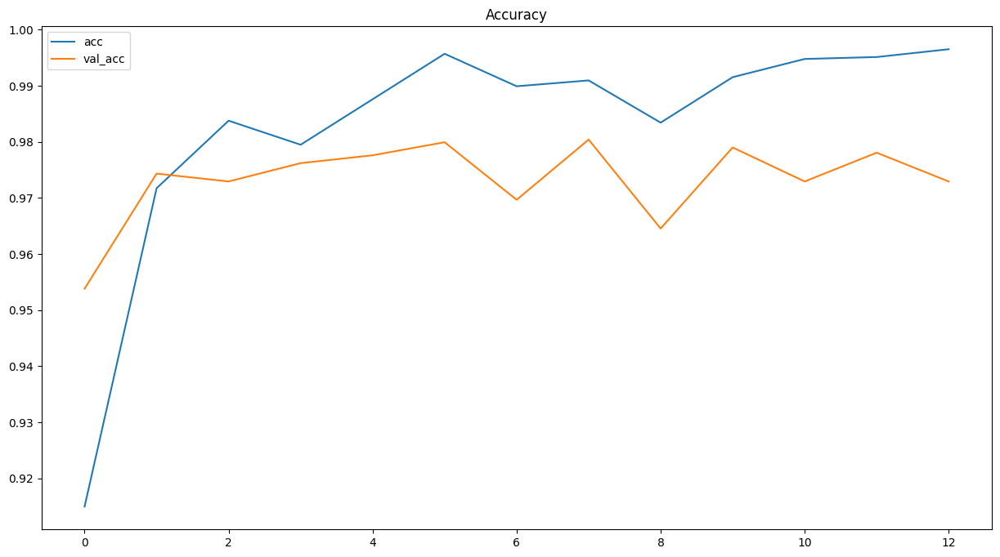

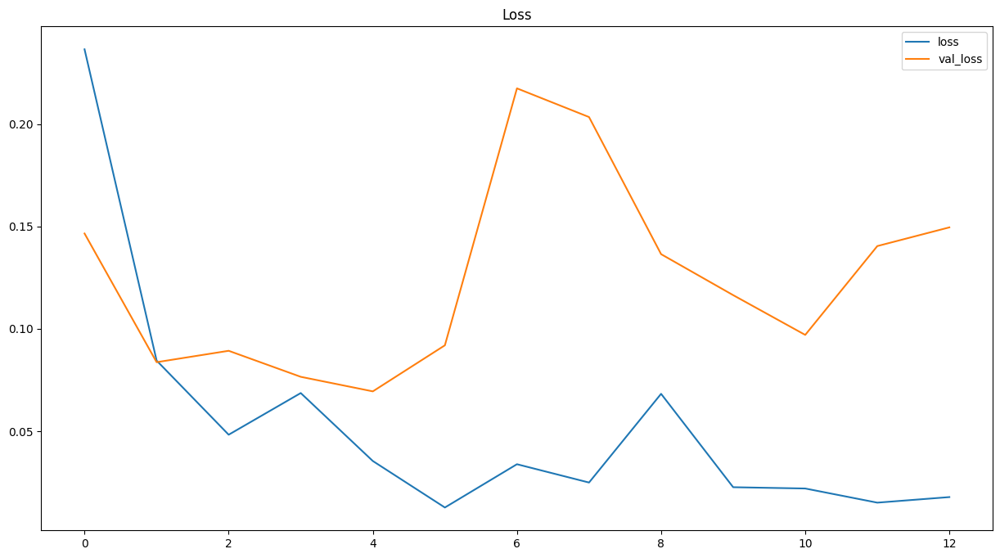

In [ ]:
plot_accuracy_and_loss_model(hist_cnn)

In [ ]:
loss, acc = vgg_model.evaluate(test_it, steps=test_it.samples//32)
print("Accuracy: ",acc)

37/37 [==============================] - 12s 327ms/step - loss: 0.0819 - accuracy: 0.9704
Accuracy:  0.9704391956329346


In [ ]:
probs = vgg_model.predict(test_it, steps=test_it.samples//32)

print(f'{probs.shape}')
y_pred = np.argmax(probs,axis=1)

37/37 [==============================] - 11s 291ms/step
(1184, 3)


In [ ]:
print(classification_report(y_test.astype(int), y_pred))

              precision    recall  f1-score   support

           0       0.95      0.98      0.97       495
           1       0.99      0.95      0.97       477
           2       0.99      0.98      0.98       212

    accuracy                           0.97      1184
   macro avg       0.97      0.97      0.97      1184
weighted avg       0.97      0.97      0.97      1184



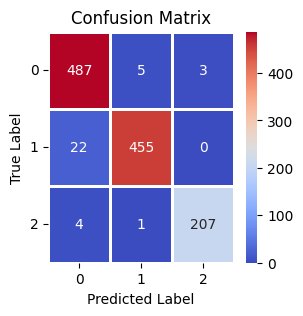

In [ ]:
compute_and_show_confusion_matrix(y_test, y_pred)

9/9 [==============================] - 0s 7ms/step
[1 0 1 1 1 1 1 0 1]


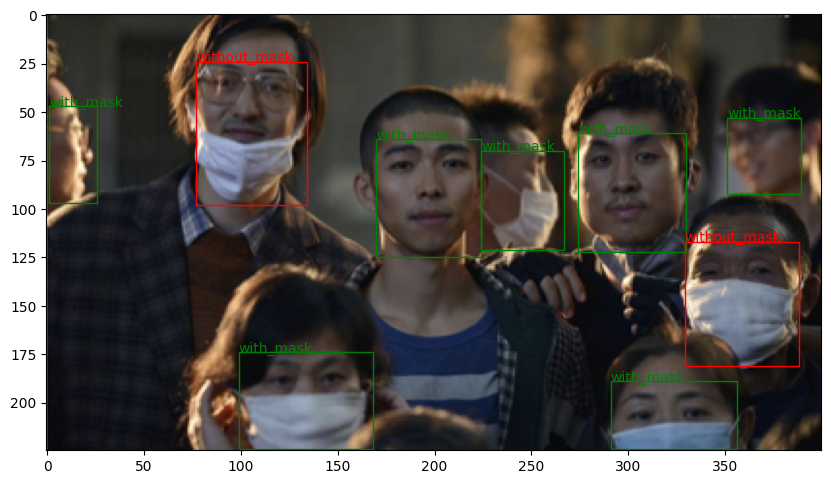

In [ ]:
test_on_real_photo(vgg_model)

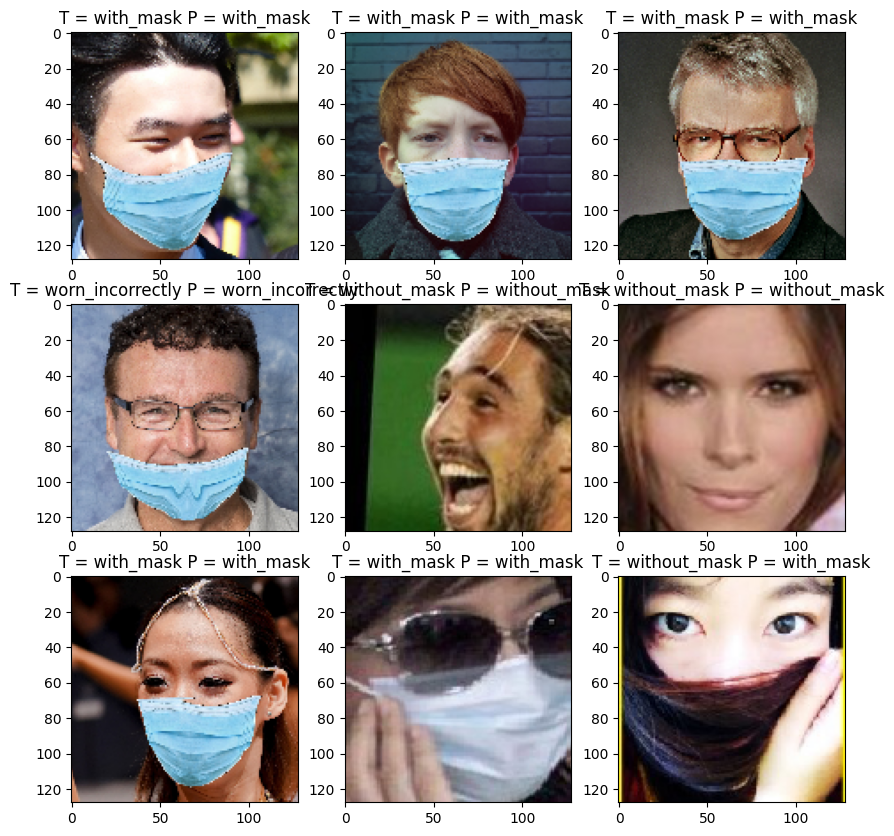

In [ ]:
plt.rcParams["figure.figsize"] = (10,10)
import random
index = 0
# random.seed(42)

labels = ['with_mask', 'without_mask', 'worn_incorrectly']

for i in  random.sample(range(0, 1084), 9):
  ax = plt.subplot(330 + 1 + index)
  plt.imshow(X_test[i])
  ax.set_title('T = ' + labels[int(y_test[i])] + ' P = ' + labels[int(y_pred[i])])
  index +=1
plt.show()

## MobileNetV2

### training

In [ ]:

def define_mobilenetv2_model():
    # Load MobileNetV2 model
    base_model = MobileNetV2(include_top=False, input_shape=(64, 64, 3))

    # Add custom classifier layers
    x = base_model.output
    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dense(128, activation='relu')(x)
    predictions = layers.Dense(3, activation='softmax')(x)

    # Create the full model
    full_model = Model(inputs=base_model.input, outputs=predictions)

    # Freeze the base model layers
    # Compile the model

    full_model.summary()
    full_model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    return full_model

mobilenet_model = define_mobilenetv2_model()


Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 64, 64, 3)]  0           []                               
                                                                                                  
 Conv1 (Conv2D)                 (None, 32, 32, 32)   864         ['input_5[0][0]']                
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 32, 32, 32)   128         ['Conv1[0][0]']                  
                                                                                                  
 Conv1_relu (ReLU)              (None, 32, 32, 32)   0           ['bn_Conv1[0][0]']               
                                                                                            

In [ ]:
epochs = 30
hist_cnn = mobilenet_model.fit(
            train_it,
            epochs=epochs,
            validation_data=val_it,
            max_queue_size=100,
            workers = 5 ,# (set a proper value > 1)
            use_multiprocessing=True,
            steps_per_epoch = train_it.samples//32,
            validation_steps = val_it.samples//32,
            callbacks = [early_stopping]
)

mobilenet_model.save("mobilenet_model_fc")

Epoch 1/30
270/270 [==============================] - 214s 555ms/step - loss: 0.1600 - accuracy: 0.9531 - val_loss: 0.8438 - val_accuracy: 0.9202
Epoch 2/30
270/270 [==============================] - 170s 627ms/step - loss: 0.0861 - accuracy: 0.9724 - val_loss: 7.2223 - val_accuracy: 0.6581
Epoch 3/30
270/270 [==============================] - 170s 624ms/step - loss: 0.0473 - accuracy: 0.9829 - val_loss: 2.6760 - val_accuracy: 0.7374
Epoch 4/30
270/270 [==============================] - 134s 491ms/step - loss: 0.0605 - accuracy: 0.9802 - val_loss: 4.4150 - val_accuracy: 0.7822
Epoch 5/30
270/270 [==============================] - 175s 640ms/step - loss: 0.0477 - accuracy: 0.9862 - val_loss: 1.8630 - val_accuracy: 0.8274
Epoch 6/30
270/270 [==============================] - 136s 497ms/step - loss: 0.0327 - accuracy: 0.9888 - val_loss: 2.5727 - val_accuracy: 0.7341
Epoch 7/30
270/270 [==============================] - 129s 469ms/step - loss: 0.0349 - accuracy: 0.9889 - val_loss: 5.2171 -

In [15]:
if not 'mobilenet_model' in vars():
    mobilenet_model = load_model('drive/MyDrive/models/mobilenet_model_fc')

### testing

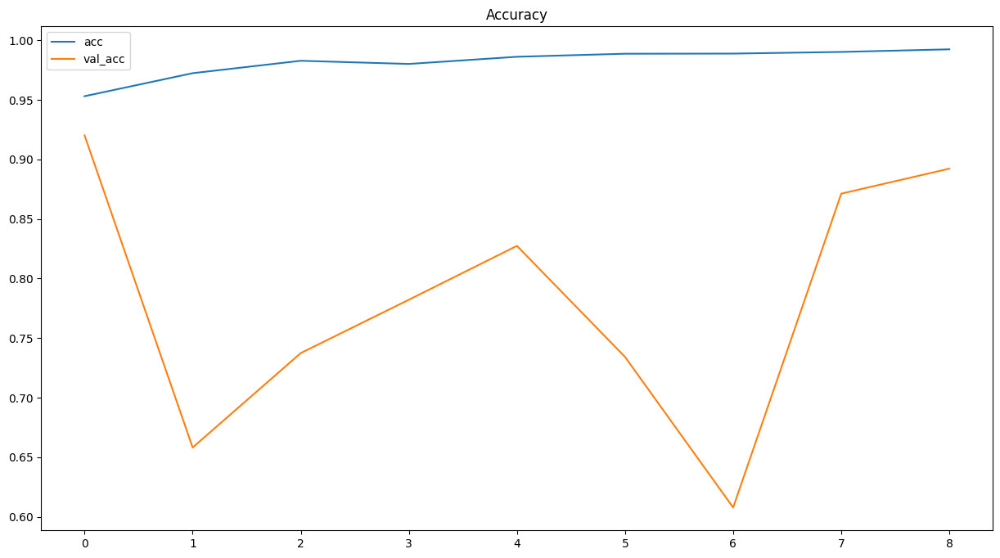

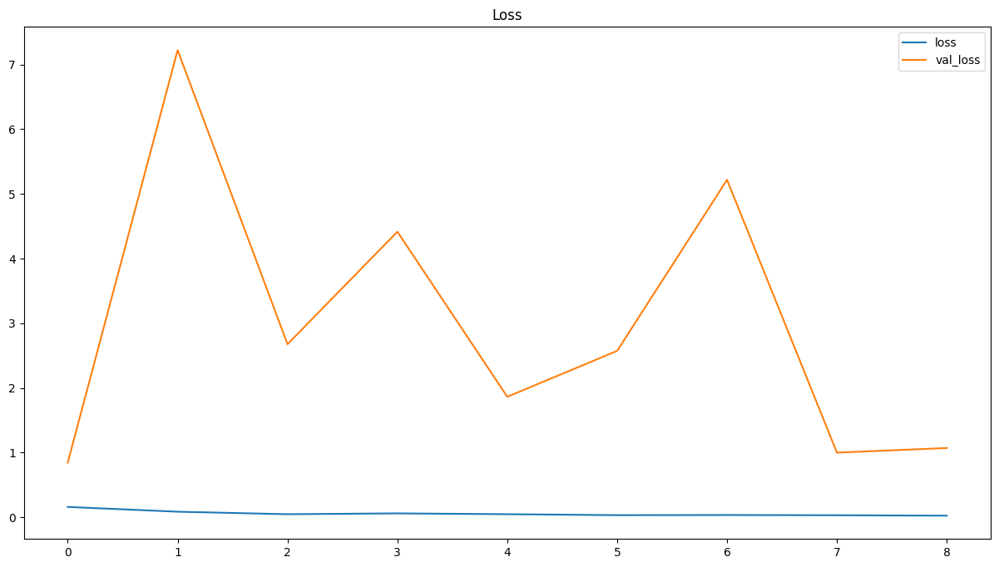

In [ ]:
plot_accuracy_and_loss_model(hist_cnn)

In [ ]:
loss, acc = mobilenet_model.evaluate(test_it, steps=test_it.samples//32)
print("Accuracy: ",acc)

37/37 [==============================] - 13s 359ms/step - loss: 0.6722 - accuracy: 0.9265
Accuracy:  0.9265202879905701


In [ ]:
probs = mobilenet_model.predict(test_it, steps=test_it.samples//32)

print(f'{probs.shape}')
y_pred = np.argmax(probs,axis=1)

37/37 [==============================] - 13s 327ms/step
(1184, 3)


In [ ]:
print(classification_report(y_test.astype(int), y_pred))

              precision    recall  f1-score   support

           0       0.93      0.94      0.94       495
           1       0.93      0.95      0.94       477
           2       0.91      0.86      0.88       212

    accuracy                           0.93      1184
   macro avg       0.92      0.91      0.92      1184
weighted avg       0.93      0.93      0.93      1184



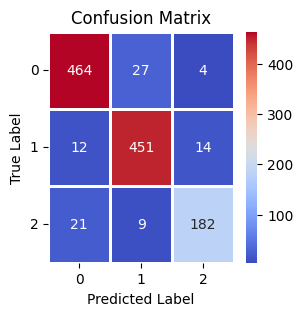

In [ ]:
compute_and_show_confusion_matrix(y_test, y_pred)

9/9 [==============================] - 1s 10ms/step
[1 1 1 1 1 1 1 1 1]


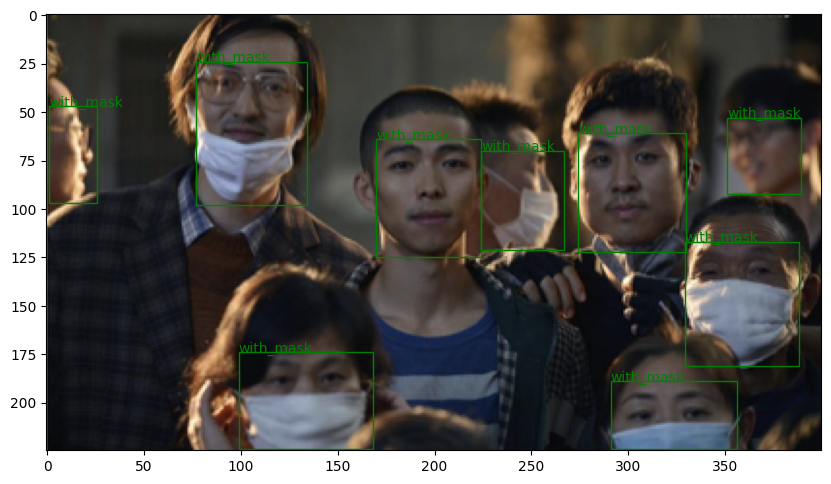

In [ ]:
test_on_real_photo(mobilenet_model)

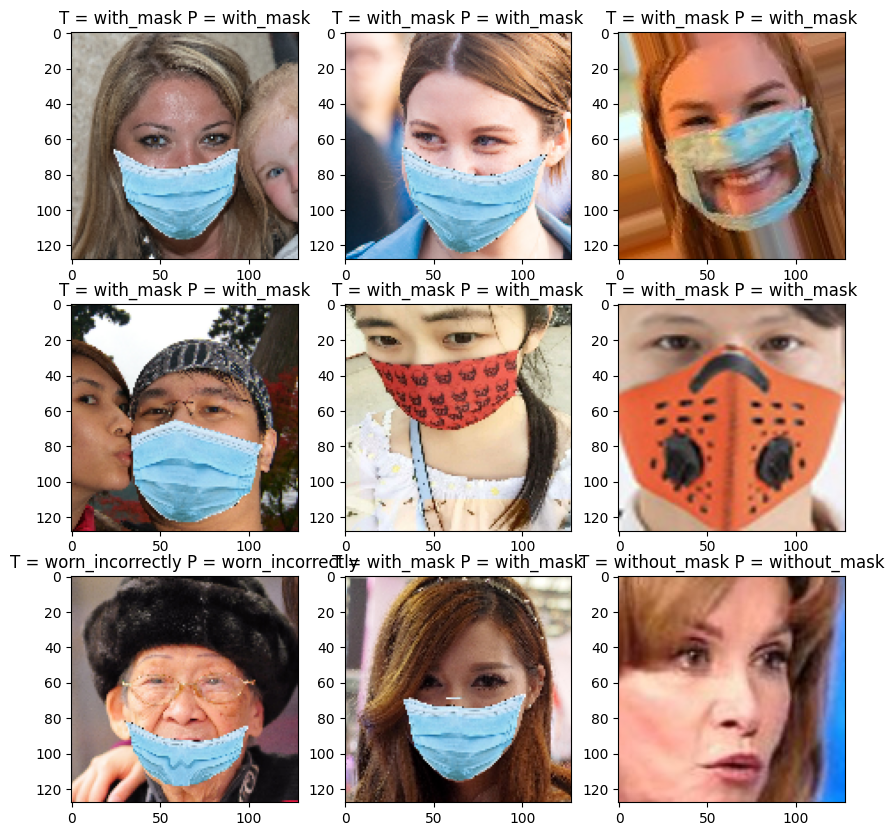

In [ ]:
plt.rcParams["figure.figsize"] = (10,10)
import random
index = 0
# random.seed(42)

labels = ['with_mask', 'without_mask', 'worn_incorrectly']

for i in  random.sample(range(0, 1084), 9):
  ax = plt.subplot(330 + 1 + index)
  plt.imshow(X_test[i])
  ax.set_title('T = ' + labels[int(y_test[i])] + ' P = ' + labels[int(y_pred[i])])
  index +=1
plt.show()

## Thrid CNN model

In [ ]:
cnn_model3 = models.Sequential([
    layers.Conv2D(16, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0,3),

    layers.Conv2D(32, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0,3),

    layers.Conv2D(64, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0,3),

    layers.Conv2D(128, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0,3),

    layers.Conv2D(256, (3,3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0,3),

    layers.Flatten(),

    layers.Dense(256, activation='relu'),
    layers.Dense(3, activation='softmax')
])

cnn_model3.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 126, 126, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 16)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 63, 63, 16)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 30, 30, 32)       0         
 2D)                                                             
                                                                 
 dropout_1 (Dropout)         (None, 30, 30, 32)       

In [ ]:
cnn_model3.compile(loss='sparse_categorical_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy']
)


In [ ]:
epochs = 30
hist_cnn = cnn_model3.fit(
            train_it,
            epochs=epochs,
            validation_data=val_it,
            max_queue_size=100,
            workers = 5 ,# (set a proper value > 1)
            use_multiprocessing=True,
            steps_per_epoch = train_it.samples//32,
            validation_steps = val_it.samples//32,
            callbacks = [early_stopping]
)
cnn_model3.save('cnn_model3.h')

Epoch 1/30
270/270 [==============================] - 122s 388ms/step - loss: 0.2842 - accuracy: 0.8939 - val_loss: 0.2464 - val_accuracy: 0.9184
Epoch 2/30
270/270 [==============================] - 114s 419ms/step - loss: 0.1835 - accuracy: 0.9383 - val_loss: 0.1908 - val_accuracy: 0.9394
Epoch 3/30
270/270 [==============================] - 113s 412ms/step - loss: 0.1538 - accuracy: 0.9488 - val_loss: 0.1399 - val_accuracy: 0.9580
Epoch 4/30
270/270 [==============================] - 115s 424ms/step - loss: 0.1384 - accuracy: 0.9529 - val_loss: 0.1432 - val_accuracy: 0.9534
Epoch 5/30
270/270 [==============================] - 120s 428ms/step - loss: 0.1238 - accuracy: 0.9562 - val_loss: 0.2014 - val_accuracy: 0.9314
Epoch 6/30
270/270 [==============================] - 114s 416ms/step - loss: 0.1154 - accuracy: 0.9611 - val_loss: 0.1411 - val_accuracy: 0.9552
Epoch 7/30
270/270 [==============================] - 122s 442ms/step - loss: 0.1042 - accuracy: 0.9630 - val_loss: 0.1340 -

In [13]:
if not 'cnn_model3' in vars():
    cnn_model3 = load_model('drive/MyDrive/models/cnn_model3.h')

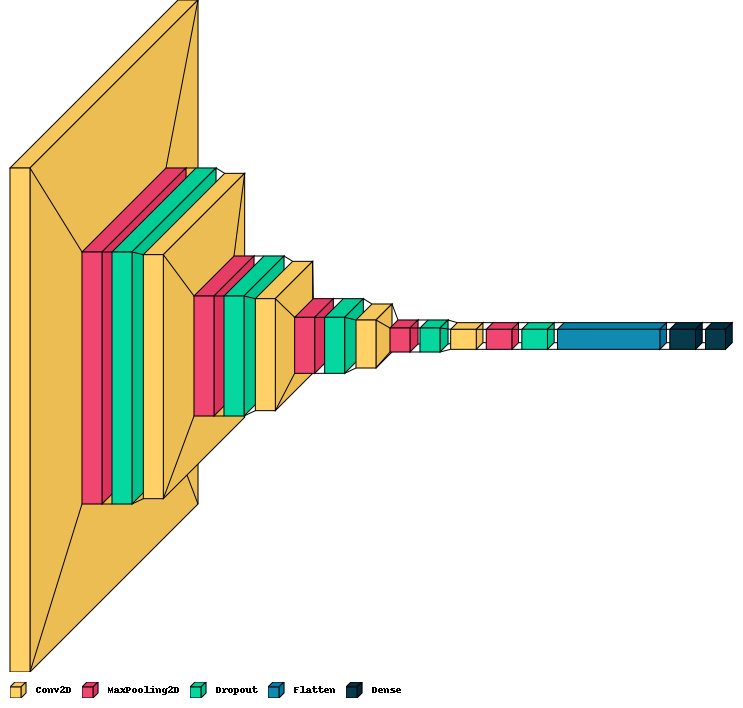

In [ ]:
visualkeras.layered_view(cnn_model3, legend=True).show()


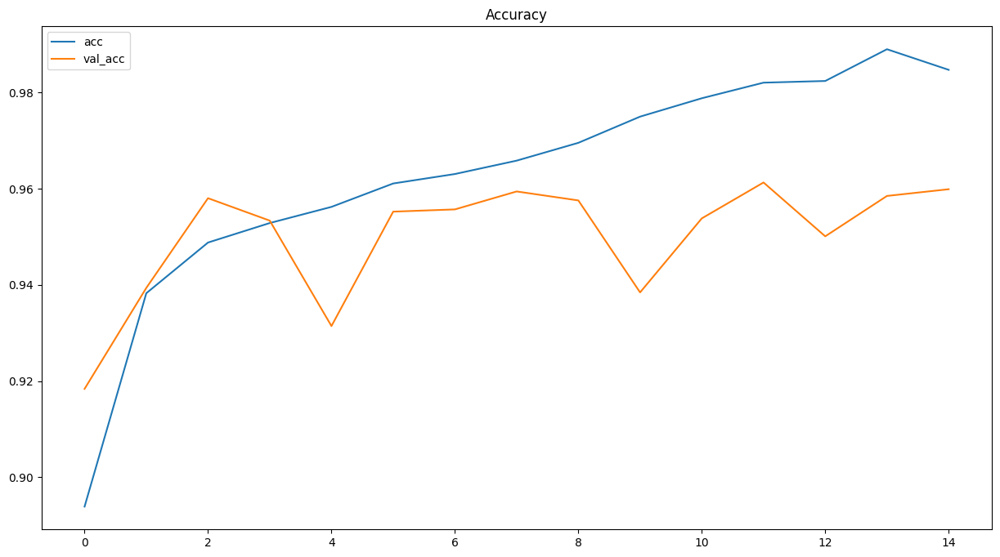

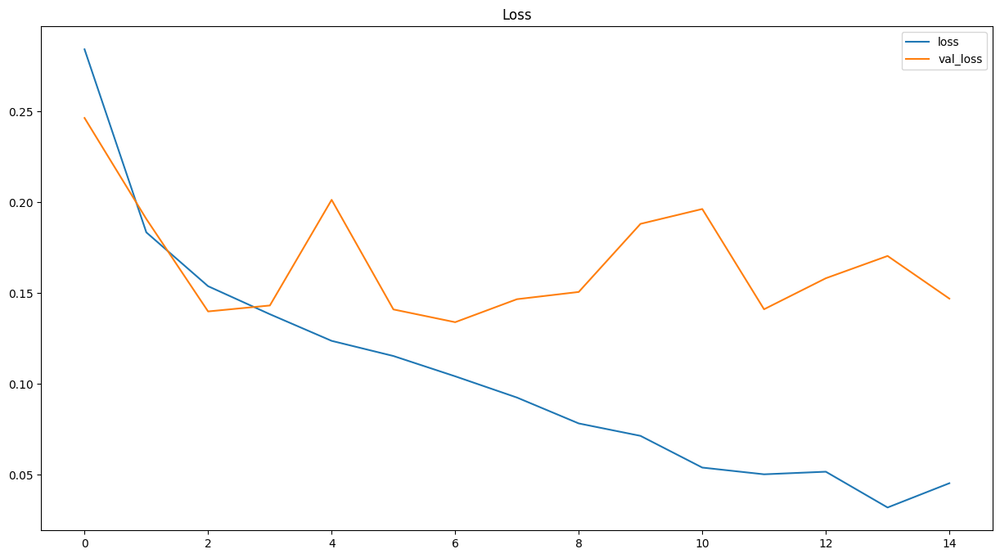

In [ ]:
plot_accuracy_and_loss_model(hist_cnn)

In [ ]:
loss, acc = cnn_model3.evaluate(test_it, steps=test_it.samples//32)
print("Accuracy: ",acc)

37/37 [==============================] - 11s 297ms/step - loss: 0.1405 - accuracy: 0.9527
Accuracy:  0.9527027010917664


In [ ]:
probs = cnn_model3.predict(test_it, steps=test_it.samples//32)

print(f'{probs.shape}')
y_pred = np.argmax(probs,axis=1)

37/37 [==============================] - 14s 348ms/step
(1184, 3)


In [ ]:
print(classification_report(y_test.astype(int), y_pred))

              precision    recall  f1-score   support

           0       0.95      0.94      0.95       495
           1       0.94      0.96      0.95       477
           2       0.99      0.97      0.98       212

    accuracy                           0.95      1184
   macro avg       0.96      0.96      0.96      1184
weighted avg       0.95      0.95      0.95      1184



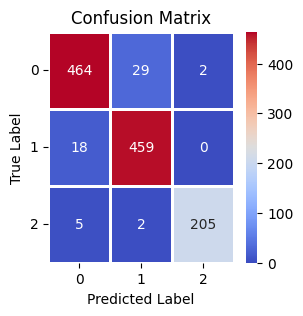

In [ ]:
compute_and_show_confusion_matrix(y_test, y_pred)

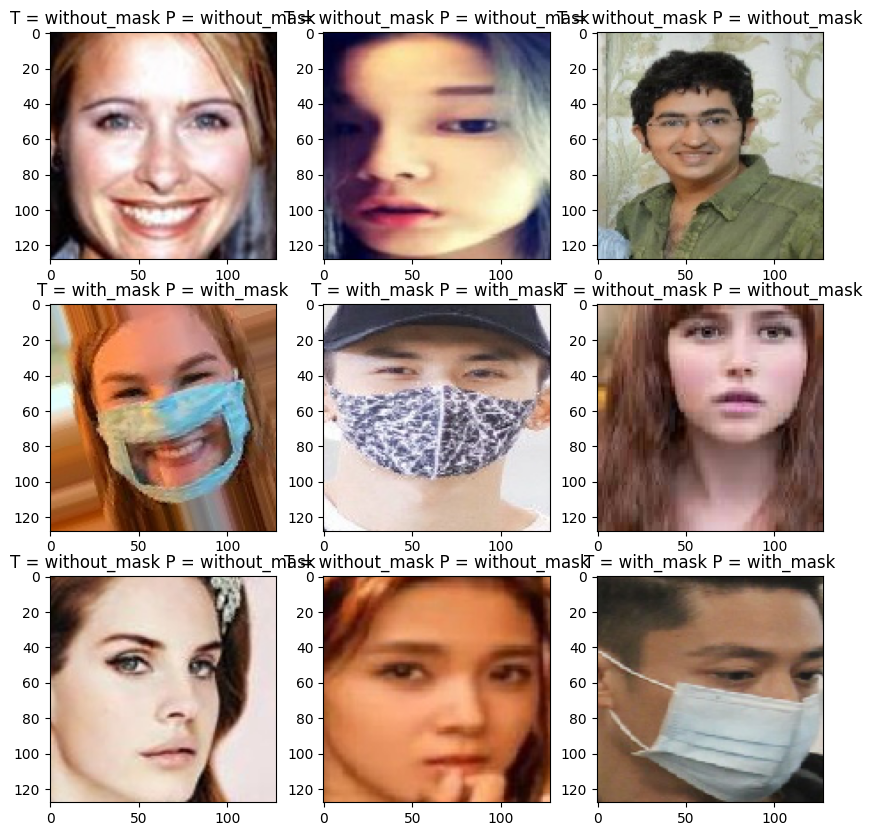

In [ ]:
plt.rcParams["figure.figsize"] = (10,10)
import random
index = 0
# random.seed(42)

labels = ['with_mask', 'without_mask', 'worn_incorrectly']

for i in  random.sample(range(0, 1084), 9):
  ax = plt.subplot(330 + 1 + index)
  plt.imshow(X_test[i])
  ax.set_title('T = ' + labels[int(y_test[i])] + ' P = ' + labels[int(y_pred[i])])
  index +=1
plt.show()

9/9 [==============================] - 0s 3ms/step
[1 1 1 1 1 1 1 1 1]


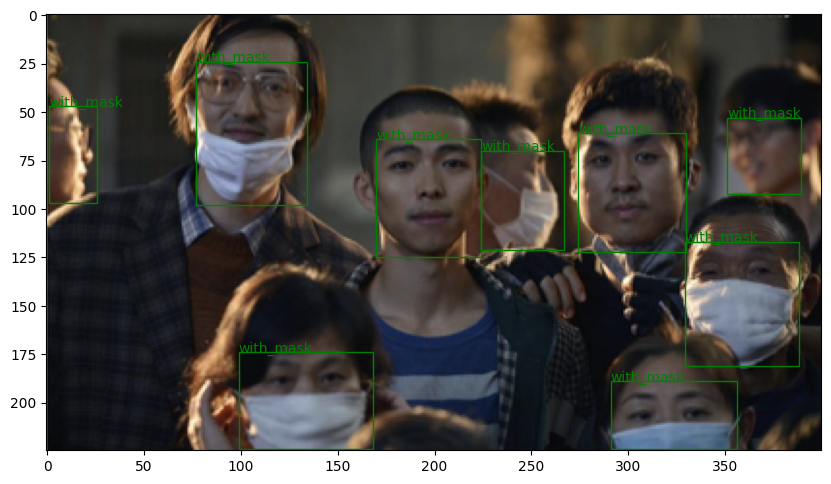

In [ ]:
test_on_real_photo(cnn_model3)

# Testing all models on real input

In [8]:
def crop_image(file, xmin, ymin, xmax, ymax):
    im_arr = np.array(file)
    # cropping
    im_cropped = im_arr[ymin:ymax, xmin:xmax, :3]
    return im_cropped

In [7]:
def plot_faces_with_labels(model, faces, image):
    labels = ['with mask' , 'without mask', 'worn incorrectly']
    for (x, y, w, h) in faces:
        ymin, ymax, xmin, xmax = y, y+h, x, x+w
        im_cropped = crop_image(image, xmin, ymin, xmax, ymax)
        im_resized = cv2.resize(im_cropped, (128, 128))
        im_resized = im_resized / 255.0
        im_test = tf.constant([im_resized])
        y_pred = model.predict(im_test).argmax(axis=1)
        plt.figure(figsize=(10,5))
        plt.title(labels[int(y_pred[0])])
        plt.imshow(im_cropped)

In [6]:
def predict_and_plot(faces, image, model):
    labels = ['green', 'red', 'yellow']
    annotation = ['with_mask', 'without_mask', 'mask_worn_incorrect']
    fig, ax = plt.subplots(1)
    colored_img = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    ax.imshow(colored_img)
    plt.title(f"INFO: Found {len(faces)} faces !!")

    for (x, y, w, h) in faces:
            ymin, ymax, xmin, xmax = y, y+h, x, x+w
            im_cropped = crop_image(image, xmin, ymin, xmax, ymax)
            im_resized = cv2.resize(im_cropped, (128, 128))
            im_resized = im_resized / 255.0
            im_test = tf.constant([im_resized])
            y_pred = model.predict(im_test).argmax(axis=1)
            rectangle = cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
            rectangle = patches.Rectangle(
                xy=(xmin, ymin),
                width=xmax - xmin,
                height=ymax - ymin,
                linewidth=1,
                edgecolor=labels[y_pred[0]],
                facecolor='none'
                )
            ax.annotate(annotation[y_pred[0]], (xmin, ymin), color=labels[y_pred[0]])
            ax.add_patch(rectangle)

    plt.imshow(image)
    plt.show()


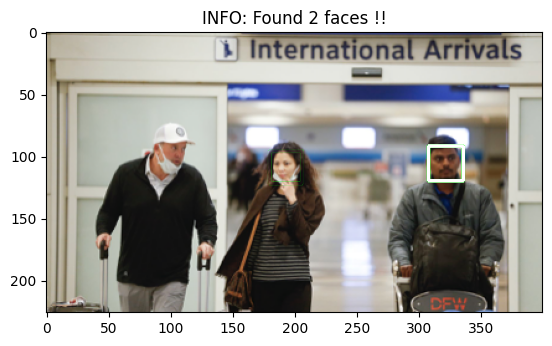

In [5]:
from skimage import io
image = io.imread("data/detection/maksssksksss145.png")

gray_img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
faceCascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")
faces = faceCascade.detectMultiScale(
    gray_img,
    scaleFactor=1.1,
    minSize=(10,10),
    minNeighbors=1,
    maxSize=(50,50)

)

plt.title(f"INFO: Found {len(faces)} faces !!")
for (x, y, w, h) in faces:
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
    plt.imshow(image)
plt.show()

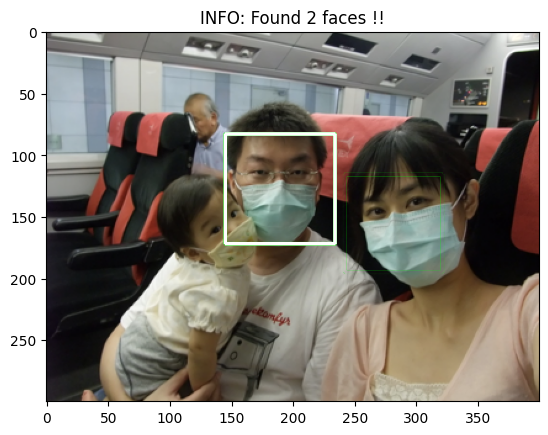

In [9]:
from skimage import io
image2 = io.imread("data/detection/maksssksksss7.png")

gray_img = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)
faceCascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")
faces2 = faceCascade.detectMultiScale(
    gray_img,
    scaleFactor=1.1,
    minSize=(20,20),
    minNeighbors=1,
    maxSize=(300,300)

)

plt.title(f"INFO: Found {len(faces2)} faces !!")
for (x, y, w, h) in faces2:
    cv2.rectangle(image2, (x, y), (x + w, y + h), (0, 255, 0), 2)
    plt.imshow(image2)
plt.show()

### CNN

1/1 [==============================] - 0s 71ms/step


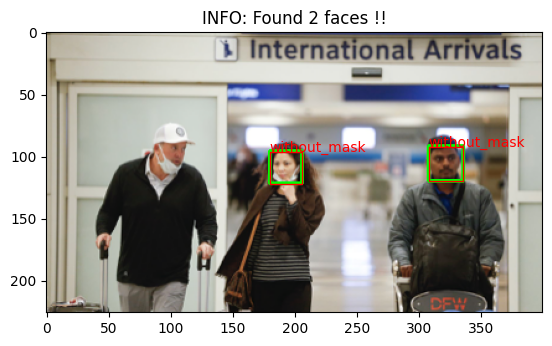

1/1 [==============================] - 0s 35ms/step


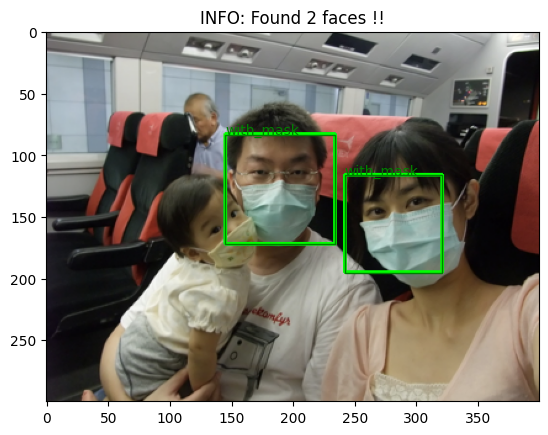

In [11]:
predict_and_plot(faces, image, cnn_model)
predict_and_plot(faces2, image2, cnn_model)

### CNN 2

1/1 [==============================] - 0s 21ms/step


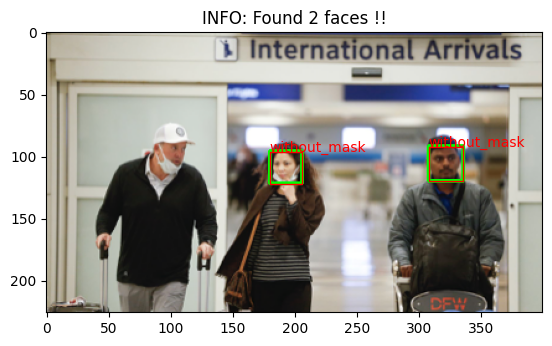

1/1 [==============================] - 0s 40ms/step


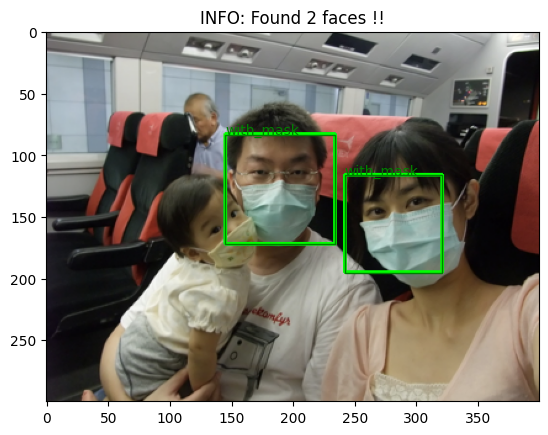

In [ ]:
predict_and_plot(faces, image, cnn_model2)
predict_and_plot(faces2, image2, cnn_model2)

### CNN 3

1/1 [==============================] - 0s 20ms/step


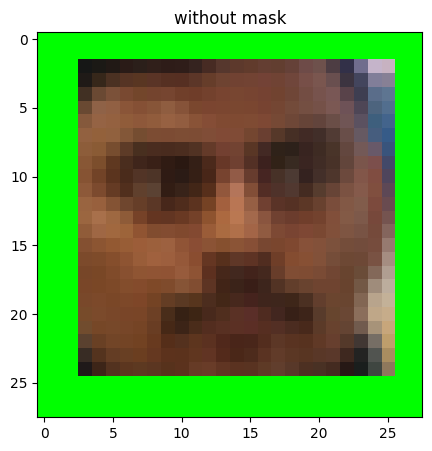

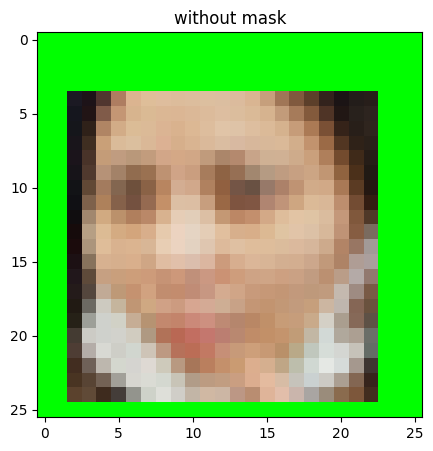

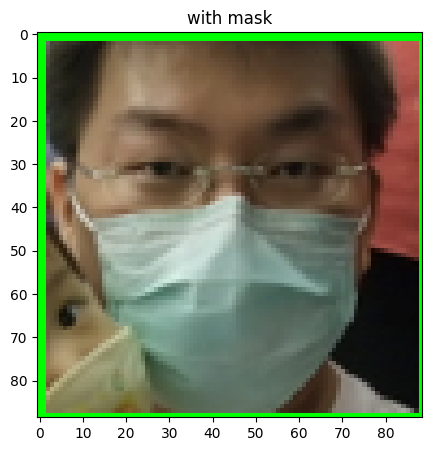

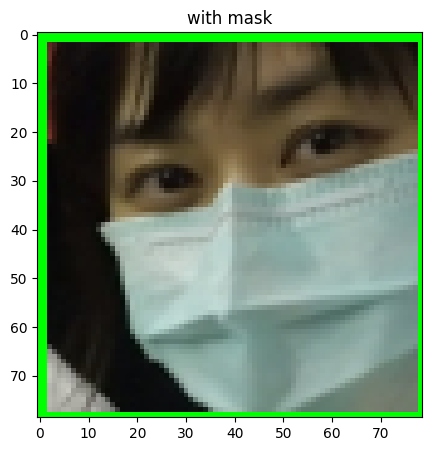

In [ ]:
plot_faces_with_labels(cnn_model3, faces, image)
plot_faces_with_labels(cnn_model3, faces2, image2)

### VGG

1/1 [==============================] - 0s 30ms/step


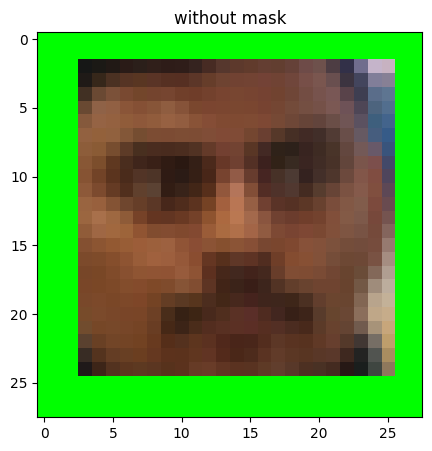

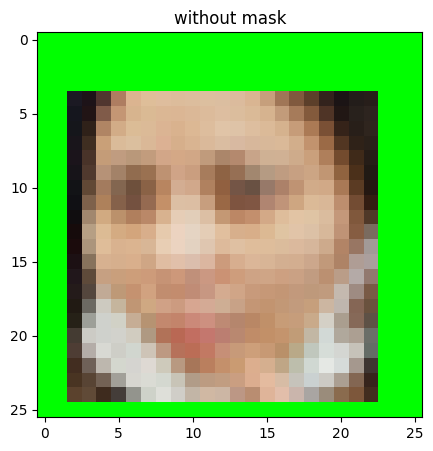

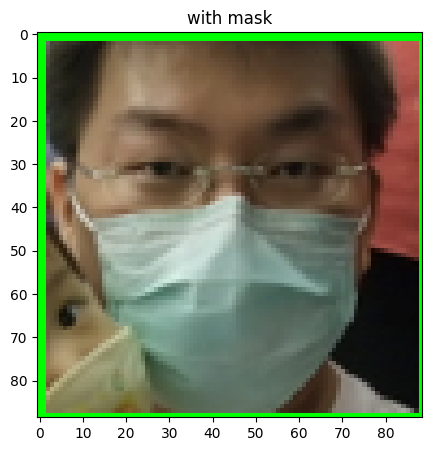

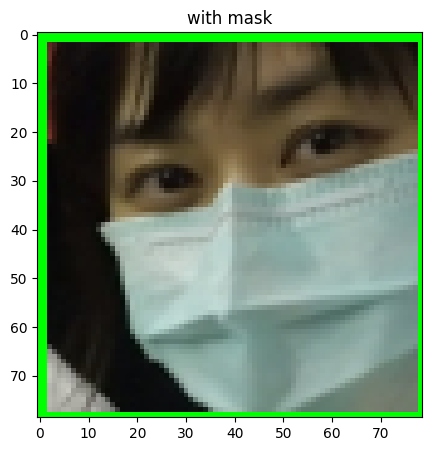

In [ ]:
plot_faces_with_labels(vgg_model, faces, image)
plot_faces_with_labels(vgg_model, faces2, image2)

### Mobilenet

1/1 [==============================] - 0s 39ms/step


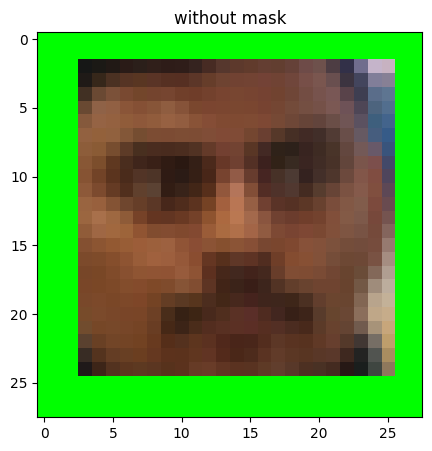

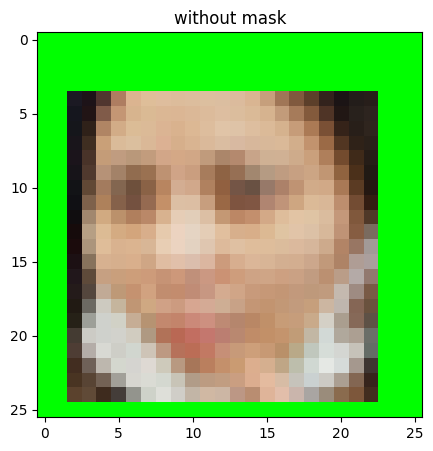

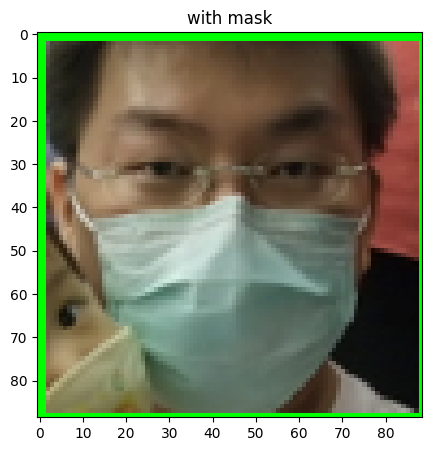

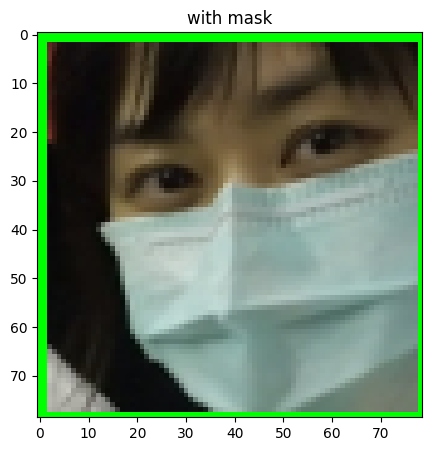

In [ ]:
plot_faces_with_labels(mobilenet_model, faces, image)
plot_faces_with_labels(mobilenet_model, faces2, image2)

In [ ]:
image = io.imread("/content/data/test/worn_incorrectly/img_588.jpg")

gray_img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
faceCascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")
faces = faceCascade.detectMultiScale(
    gray_img,
    scaleFactor=1.1,
    minSize=(200, 200),
    minNeighbors=1,
    maxSize=(1000,1000)

)


1/1 [==============================] - 0s 21ms/step


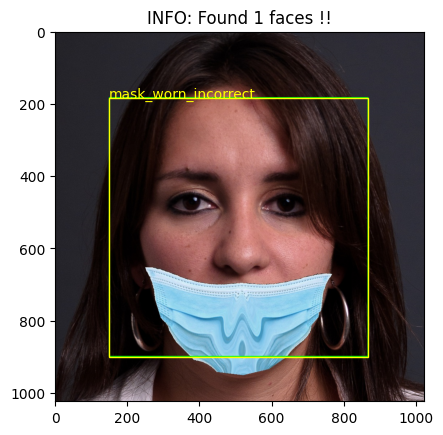

In [ ]:

predict_and_plot(faces, image, cnn_model2)

1/1 [==============================] - 0s 20ms/step


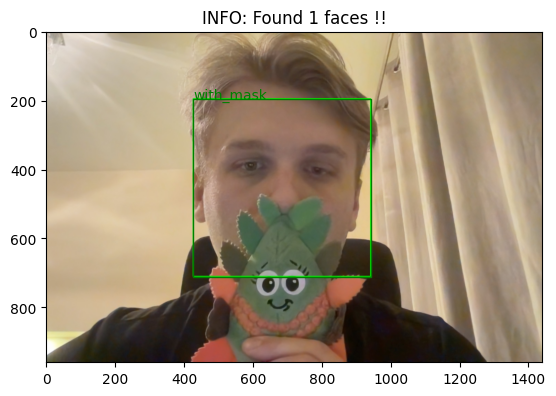

1/1 [==============================] - 0s 18ms/step


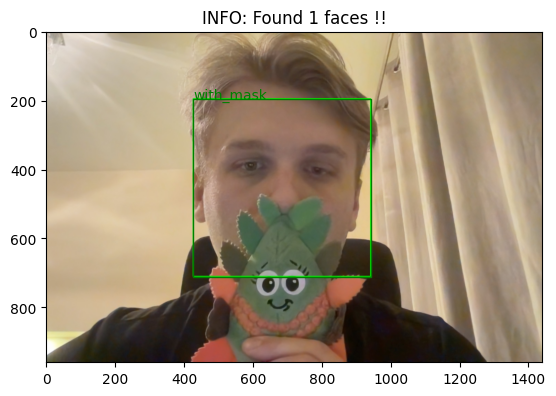

1/1 [==============================] - 0s 21ms/step


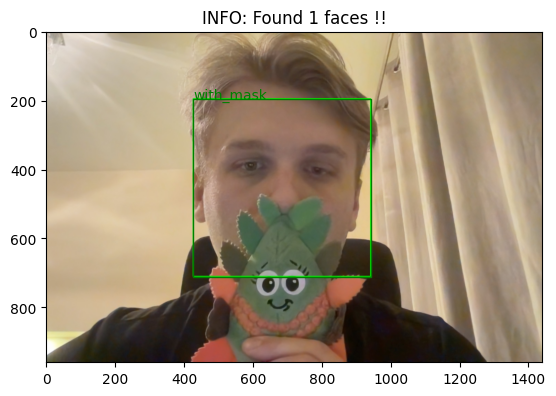

1/1 [==============================] - 0s 25ms/step


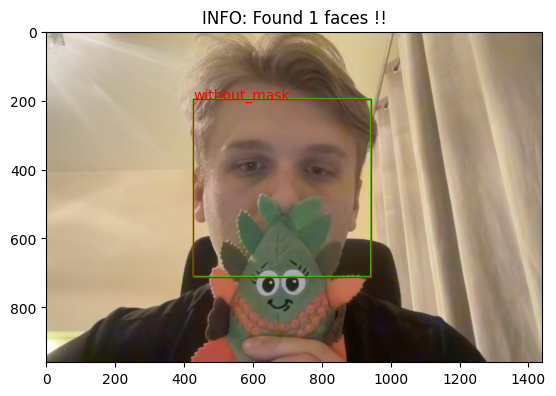

1/1 [==============================] - 0s 24ms/step


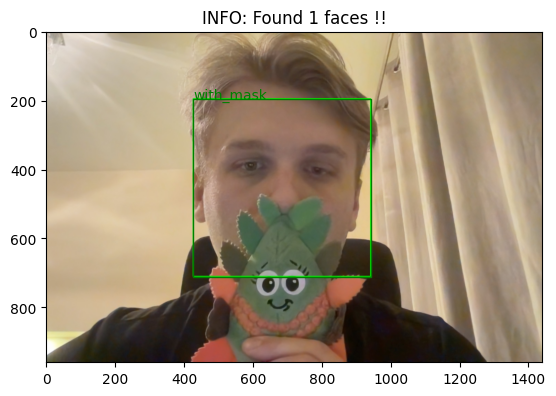

In [19]:
image = io.imread("/content/xxx2.jpg")

gray_img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
faceCascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")
faces = faceCascade.detectMultiScale(
    gray_img,
    scaleFactor=1.1,
    minSize=(200, 200),
    minNeighbors=1,
    maxSize=(1000,1000)

)

predict_and_plot(faces, image, cnn_model)
predict_and_plot(faces, image, cnn_model2)
predict_and_plot(faces, image, cnn_model3)
predict_and_plot(faces, image, vgg_model)
predict_and_plot(faces, image, mobilenet_model)



1/1 [==============================] - 0s 22ms/step


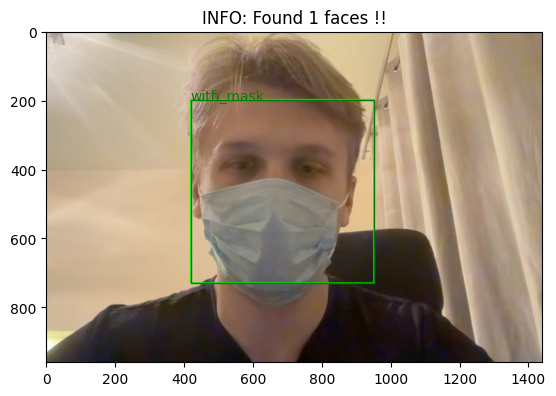

1/1 [==============================] - 0s 23ms/step


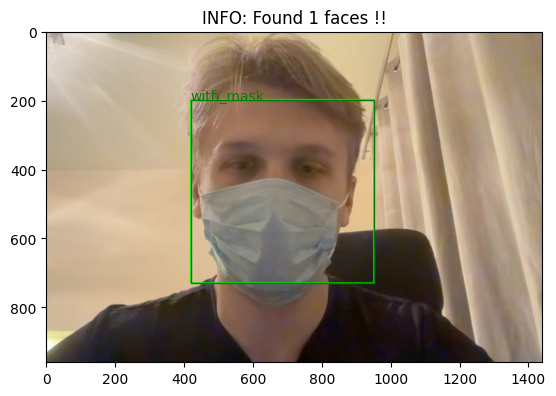

1/1 [==============================] - 0s 24ms/step


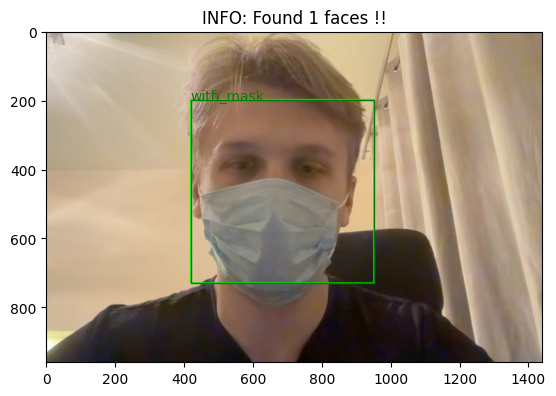

1/1 [==============================] - 0s 27ms/step


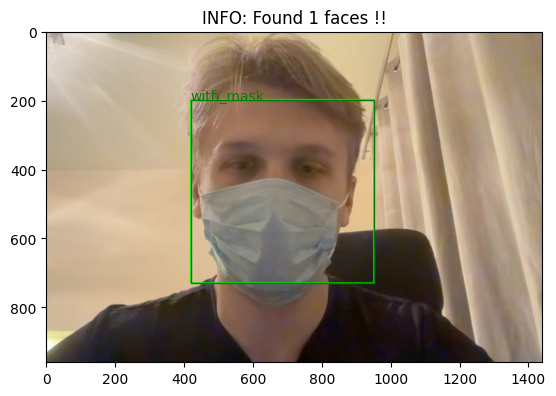

1/1 [==============================] - 0s 24ms/step


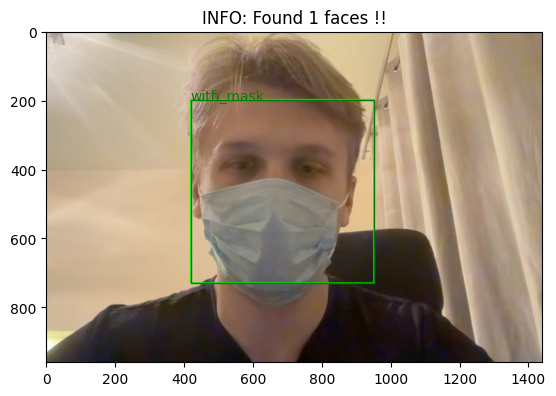

In [18]:
image = io.imread("/content/xxx7.jpg")

gray_img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
faceCascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")
faces = faceCascade.detectMultiScale(
    gray_img,
    scaleFactor=1.1,
    minSize=(200, 200),
    minNeighbors=1,
    maxSize=(1000,1000)

)

predict_and_plot(faces, image, cnn_model)
predict_and_plot(faces, image, cnn_model2)
predict_and_plot(faces, image, cnn_model3)
predict_and_plot(faces, image, vgg_model)
predict_and_plot(faces, image, mobilenet_model)

1/1 [==============================] - 0s 27ms/step


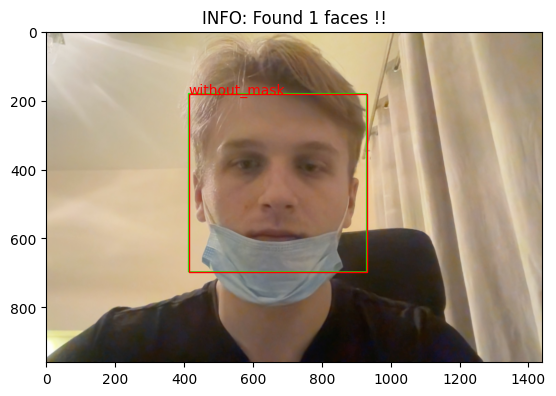

1/1 [==============================] - 0s 175ms/step


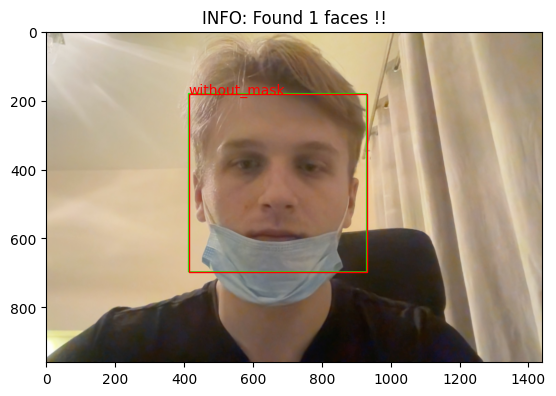

1/1 [==============================] - 0s 96ms/step


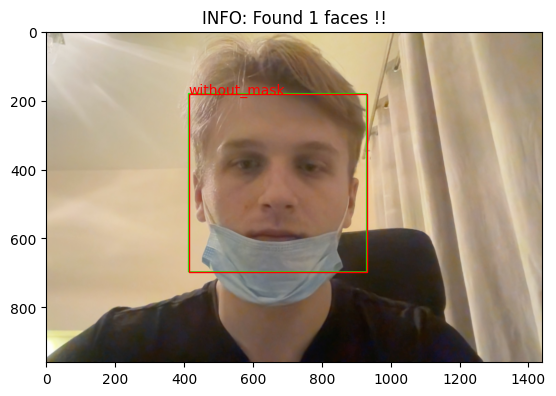

1/1 [==============================] - 1s 748ms/step


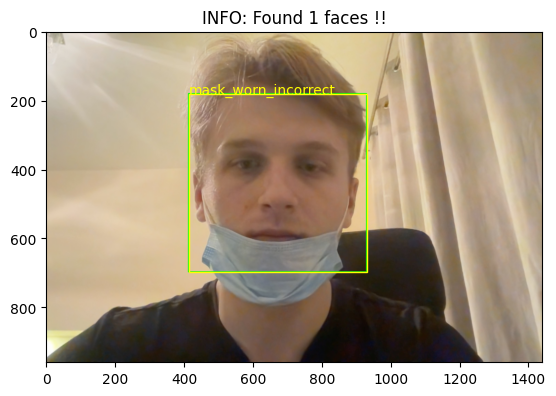

1/1 [==============================] - 2s 2s/step


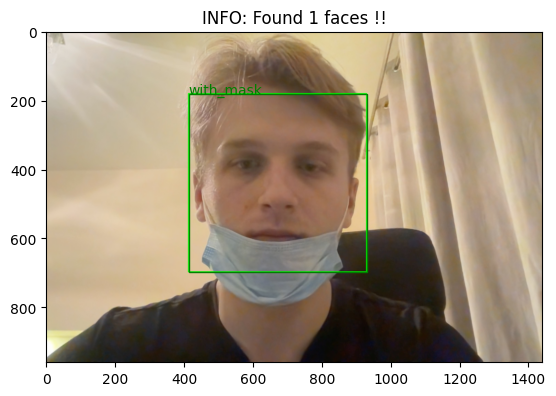

In [17]:
image = io.imread("/content/xxx3.jpg")

gray_img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
faceCascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")
faces = faceCascade.detectMultiScale(
    gray_img,
    scaleFactor=1.1,
    minSize=(200, 200),
    minNeighbors=1,
    maxSize=(1000,1000)

)

predict_and_plot(faces, image, cnn_model)
predict_and_plot(faces, image, cnn_model2)
predict_and_plot(faces, image, cnn_model3)
predict_and_plot(faces, image, vgg_model)
predict_and_plot(faces, image, mobilenet_model)